# Project description

You're an intern analyst for Yandex.Afisha. Your first task is to help optimize marketing expenses.

You have:
*	Server logs with data on Yandex.Afisha visits from June 2017 through May 2018
*	Dump file with all orders for the period
*	Marketing expenses statistics

In this assingment, we will first take a look at the datasets, treat problematic data (if there is any), enrich the data with additional factors (if needed), and carry out an analysis in order to study:
*	How people use the product
*	When they start to buy
*	How much money each customer brings
*	When they pay off

we will be able to study these parameters by taking a deeper look at each of our datasets, by making reports, calculating metrics and ploting graphs. finaly we will be able to make conclusions, and advise the marketing experts how much money to invest and where.

## Initialization

In [1]:
# Loading all the libraries

import matplotlib.pyplot as plt
import pandas as pd
import statistics
import numpy as np
from collections import Counter
import math
import seaborn as sns
from scipy import stats as st
from datetime import datetime
import matplotlib.lines as mlines
import plotly.express as px
import plotly.graph_objects as go

import warnings

warnings.filterwarnings("ignore")

### Load data

In [2]:
# Load the data files into a DataFrame

df_visits = pd.read_csv('visits_log_us.csv')
df_orders = pd.read_csv('orders_log_us.csv')
df_costs = pd.read_csv('costs_us.csv')

### Explore initial data

let's take a look at the general/summary information about the each DataFrame

#### The visits table
server logs with data on website visits:

* 'Uid' — user's unique identifier
* 'Device' — user's device
* 'Start Ts' — session start date and time
* 'End Ts' — session end date and time
* 'Source Id' — identifier of the ad source the user came from

In [3]:
df_visits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Device     359400 non-null  object 
 1   End Ts     359400 non-null  object 
 2   Source Id  359400 non-null  int64  
 3   Start Ts   359400 non-null  object 
 4   Uid        359400 non-null  float64
dtypes: float64(1), int64(1), object(3)
memory usage: 13.7+ MB


In [4]:
df_visits.describe()

,Source Id,Uid
count,359400.000000,3.594000e+05
mean,3.750515,9.202557e+18
std,1.917116,5.298433e+18
min,1.000000,1.186350e+13
25%,3.000000,4.613408e+18
50%,4.000000,9.227410e+18
75%,5.000000,1.372820e+19
max,10.000000,1.844670e+19


In [5]:
df_visits.describe(include=object)

,Device,End Ts,Start Ts
count,359400,359400,359400
unique,2,224209,224303
top,desktop,24/11/2017 16:51,24/11/2017 16:06
freq,262567,23,19


In [6]:
df_visits.head()

,Device,End Ts,Source Id,Start Ts,Uid
0,touch,20/12/2017 17:38,4,20/12/2017 17:20,1.687930e+19
1,desktop,19/02/2018 17:21,2,19/02/2018 16:53,1.040600e+17
2,touch,01/07/2017 1:54,5,01/07/2017 1:54,7.459040e+18
3,desktop,20/05/2018 11:23,9,20/05/2018 10:59,1.617470e+19
4,desktop,27/12/2017 14:06,3,27/12/2017 14:06,9.969690e+18


In [7]:
df_visits.tail()

,Device,End Ts,Source Id,Start Ts,Uid
359395,desktop,29/07/2017 19:07,2,29/07/2017 19:07,1.836330e+19
359396,touch,25/01/2018 17:38,1,25/01/2018 17:38,1.837080e+19
359397,desktop,03/03/2018 10:12,4,03/03/2018 10:12,1.838730e+19
359398,desktop,02/11/2017 10:12,5,02/11/2017 10:12,1.838860e+19
359399,touch,10/09/2017 13:13,2,10/09/2017 13:13,1.839610e+19


In [8]:
df_visits.sample()

,Device,End Ts,Source Id,Start Ts,Uid
215312,desktop,19/11/2017 16:54,4,19/11/2017 16:47,4.378690e+17


In [9]:
df_visits['Source Id'].value_counts()

4     101794
3      85610
5      66905
2      47626
1      34121
9      13277
10     10025
7         36
6          6
Name: Source Id, dtype: int64

In [10]:
df_visits['Device'].value_counts()

desktop    262567
touch       96833
Name: Device, dtype: int64

#### The orders table
data on orders:

* 'Uid' — unique identifier of the user making an order
* 'Buy Ts' — order date and time
* 'Revenue' — Yandex.Afisha's revenue from the order

In [11]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50415 entries, 0 to 50414
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Buy Ts   50415 non-null  object 
 1   Revenue  50415 non-null  float64
 2   Uid      50415 non-null  float64
dtypes: float64(2), object(1)
memory usage: 1.2+ MB


In [12]:
df_orders.describe()

,Revenue,Uid
count,50415.000000,5.041500e+04
mean,4.999647,9.098161e+18
std,21.818359,5.285741e+18
min,0.000000,3.135780e+14
25%,1.220000,4.533565e+18
50%,2.500000,9.102270e+18
75%,4.890000,1.368290e+19
max,2633.280000,1.844620e+19


In [13]:
df_orders.describe(include=object)

,Buy Ts
count,50415
unique,45991
top,31/05/2018 10:13
freq,9


In [14]:
df_orders.head()

,Buy Ts,Revenue,Uid
0,01/06/2017 0:10,17.00,1.032930e+19
1,01/06/2017 0:25,0.55,1.162730e+19
2,01/06/2017 0:27,0.37,1.790370e+19
3,01/06/2017 0:29,0.55,1.610920e+19
4,01/06/2017 7:58,0.37,1.420060e+19


In [15]:
df_orders.tail()

,Buy Ts,Revenue,Uid
50410,31/05/2018 23:50,4.64,1.229660e+19
50411,31/05/2018 23:50,5.80,1.136960e+19
50412,31/05/2018 23:54,0.30,1.786460e+18
50413,31/05/2018 23:56,3.67,3.993700e+18
50414,01/06/2018 0:02,3.42,8.387280e+16


In [16]:
df_orders.sample()

,Buy Ts,Revenue,Uid
49937,31/05/2018 10:27,5.5,1.426270e+19


#### The costs table
data on marketing expenses:

* 'source_id' — ad source identifier
* 'dt' — date
* 'costs' — expenses on this ad source on this day

In [17]:
df_costs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2542 entries, 0 to 2541
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   source_id  2542 non-null   int64  
 1   dt         2542 non-null   object 
 2   costs      2542 non-null   float64
dtypes: float64(1), int64(1), object(1)
memory usage: 59.7+ KB


In [18]:
df_costs.describe()

,source_id,costs
count,2542.000000,2542.000000
mean,4.857199,129.477427
std,3.181581,156.296628
min,1.000000,0.540000
25%,2.000000,21.945000
50%,4.000000,77.295000
75%,9.000000,170.065000
max,10.000000,1788.280000


In [19]:
df_costs.describe(include=object)

,dt
count,2542
unique,364
top,01/06/2017
freq,7


In [20]:
df_costs.head()

,source_id,dt,costs
0,1,01/06/2017,75.20
1,1,02/06/2017,62.25
2,1,03/06/2017,36.53
3,1,04/06/2017,55.00
4,1,05/06/2017,57.08


In [21]:
df_costs.tail()

,source_id,dt,costs
2537,10,27/05/2018,9.92
2538,10,28/05/2018,21.26
2539,10,29/05/2018,11.32
2540,10,30/05/2018,33.15
2541,10,31/05/2018,17.60


In [22]:
df_costs.sample()

,source_id,dt,costs
774,3,19/07/2017,174.5


In [23]:
df_costs['source_id'].value_counts()

5     364
1     363
2     363
3     363
4     363
9     363
10    363
Name: source_id, dtype: int64

### Conclusions and further steps

an initial glance at the data revieles 2 issues:
- problematic column names in df_visits ('End Ts', 'Start Ts', 'Source Id'), and df-orders ('Buy Ts') - although it is nor critical, it's better the column names are 1 string (with words seperated by _) rather than individual words seperated by blanck space.
- date columns, in all of the datasets, have an incorrect data types - object instead of datetime.

befor we can begin analyzing the dataset, we'll the next step will be to address the issues:
- change the problematic columns' names
- change the date columns to datetime data types.

## prepare the data

### problematic column names

in each column, where the column name has several srings, we will change the space to '_' and create 1 sting

In [24]:
#change column names in df_visits

df_visits.rename(columns={"End Ts": "End_Ts", "Source Id": "Source_Id", "Start Ts": "Start_Ts"}, inplace=True)

In [25]:
#make sure it worked

df_visits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Device     359400 non-null  object 
 1   End_Ts     359400 non-null  object 
 2   Source_Id  359400 non-null  int64  
 3   Start_Ts   359400 non-null  object 
 4   Uid        359400 non-null  float64
dtypes: float64(1), int64(1), object(3)
memory usage: 13.7+ MB


In [26]:
#change column name in df_orders

df_orders.rename(columns={"Buy Ts": "Buy_Ts"}, inplace=True)

In [27]:
#make sure it worked

df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50415 entries, 0 to 50414
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Buy_Ts   50415 non-null  object 
 1   Revenue  50415 non-null  float64
 2   Uid      50415 non-null  float64
dtypes: float64(2), object(1)
memory usage: 1.2+ MB


### incorrect data types

we'll use pandas to_datetime function to address the relevent columns

In [28]:
df_visits['End_Ts'] = pd.to_datetime(df_visits['End_Ts'])#, format='%Y-%m-%d %H:%M:%S')

In [29]:
df_visits['Start_Ts'] = pd.to_datetime(df_visits['Start_Ts'])#, format='%Y-%m-%d %H:%M:%S')

In [30]:
df_visits.head()

,Device,End_Ts,Source_Id,Start_Ts,Uid
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,1.687930e+19
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,1.040600e+17
2,touch,2017-01-07 01:54:00,5,2017-01-07 01:54:00,7.459040e+18
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,1.617470e+19
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9.969690e+18


In [31]:
df_visits.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Device     359400 non-null  object        
 1   End_Ts     359400 non-null  datetime64[ns]
 2   Source_Id  359400 non-null  int64         
 3   Start_Ts   359400 non-null  datetime64[ns]
 4   Uid        359400 non-null  float64       
dtypes: datetime64[ns](2), float64(1), int64(1), object(1)
memory usage: 13.7+ MB


In [32]:
df_orders['Buy_Ts'] = pd.to_datetime(df_orders['Buy_Ts'])#, format='%Y-%m-%d %H:%M:%S')

In [33]:
df_orders.head()

,Buy_Ts,Revenue,Uid
0,2017-01-06 00:10:00,17.00,1.032930e+19
1,2017-01-06 00:25:00,0.55,1.162730e+19
2,2017-01-06 00:27:00,0.37,1.790370e+19
3,2017-01-06 00:29:00,0.55,1.610920e+19
4,2017-01-06 07:58:00,0.37,1.420060e+19


In [34]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50415 entries, 0 to 50414
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Buy_Ts   50415 non-null  datetime64[ns]
 1   Revenue  50415 non-null  float64       
 2   Uid      50415 non-null  float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 1.2 MB


## enrich the data

during this project we will need to add new columns to the 3 original datasets, containing all sorts of calculations, also we will need to create many new dataframes. because of that, alot of the enrichment of our data we'll create as we progress in our analyses. having said that, there is some data we can enrich befor we start of the analyses, that will assist us as we progress, mainly data regarding date and time.

In [35]:
#add year value for each session in visits table

df_visits['session_year']  = df_visits['Start_Ts'].dt.year

In [36]:
#add month value for each session in visits table

df_visits['session_month'] = df_visits['Start_Ts'].dt.month

In [37]:
#add week value for each session in visits table

df_visits['session_week']  = df_visits['Start_Ts'].dt.week

In [38]:
#add date value for each session in visits table

df_visits['session_date'] = df_visits['Start_Ts'].dt.date

In [39]:
#add date of session week in visits table

df_visits['activity_week'] = df_visits['Start_Ts'].astype('datetime64[W]')

In [40]:
#add date of session week in visits table

df_visits['activity_month'] = df_visits['Start_Ts'].astype('datetime64[M]')

In [41]:
# calculate length of each session, and convert to minutes, in visits table

df_visits['session_length'] = (df_visits['End_Ts'] - df_visits['Start_Ts']).dt.total_seconds() / 60

In [42]:
# find first_activity_date for each user

first_activity_date = df_visits.groupby('Uid')['Start_Ts'].min()
first_activity_date.head()

Uid
1.186350e+13   2018-01-03 17:27:00
4.953710e+13   2018-06-02 15:55:00
2.977290e+14   2017-07-06 18:47:00
3.135780e+14   2017-09-18 22:49:00
3.253210e+14   2017-09-30 14:29:00
Name: Start_Ts, dtype: datetime64[ns]

In [43]:
#rename column

first_activity_date.name = 'first_activity_date'

first_activity_date.head()

Uid
1.186350e+13   2018-01-03 17:27:00
4.953710e+13   2018-06-02 15:55:00
2.977290e+14   2017-07-06 18:47:00
3.135780e+14   2017-09-18 22:49:00
3.253210e+14   2017-09-30 14:29:00
Name: first_activity_date, dtype: datetime64[ns]

In [44]:
#add first_activity_date column to our dataset

df_visits = df_visits.join(first_activity_date,on='Uid')

In [45]:
# take a look

df_visits.head()

,Device,End_Ts,Source_Id,Start_Ts,Uid,session_year,session_month,session_week,session_date,activity_week,activity_month,session_length,first_activity_date
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,1.687930e+19,2017,12,51,2017-12-20,2017-12-14,2017-12-01,18.0,2017-09-22 06:51:00
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,1.040600e+17,2018,2,8,2018-02-19,2018-02-15,2018-02-01,28.0,2018-02-19 16:53:00
2,touch,2017-01-07 01:54:00,5,2017-01-07 01:54:00,7.459040e+18,2017,1,1,2017-01-07,2017-01-05,2017-01-01,0.0,2017-01-07 01:54:00
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,1.617470e+19,2018,5,20,2018-05-20,2018-05-17,2018-05-01,24.0,2018-02-02 13:37:00
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9.969690e+18,2017,12,52,2017-12-27,2017-12-21,2017-12-01,0.0,2017-07-21 10:22:00


In [46]:
#find first_order_date for each user

first_order_date = df_orders.groupby('Uid')['Buy_Ts'].min()

In [47]:
#rename column

first_order_date.name = 'first_order_date'

In [48]:
#add first_order_date column to orders table

df_orders = df_orders.join(first_order_date,on='Uid')

In [49]:
#add date value for each order to orders table

df_orders['order_date'] = df_orders['Buy_Ts'].dt.date

in several parts of the analysis we need to use data on the source from which the users visited the site or made orders on it. keeping in mind a user can come, in different times, from different sources, for the purpuse of the analysis, we'll define the first source each user came from as the introduction\main source. to do so, we'll sort values by date, and find the source of the first date for each Uid

In [50]:
#find first visit for each user

first_source = df_visits.sort_values('session_date').groupby('Uid').first()['Source_Id'].reset_index()

In [51]:
#rename columns

first_source.columns=['Uid','first_source']
first_source.head()

,Uid,first_source
0,1.186350e+13,3
1,4.953710e+13,2
2,2.977290e+14,3
3,3.135780e+14,2
4,3.253210e+14,5


In [52]:
#merge it into df_visits

df_visits=df_visits.merge(first_source,on=['Uid'],how='left')

In [53]:
#take a look

df_visits.head()

,Device,End_Ts,Source_Id,Start_Ts,Uid,session_year,session_month,session_week,session_date,activity_week,activity_month,session_length,first_activity_date,first_source
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,1.687930e+19,2017,12,51,2017-12-20,2017-12-14,2017-12-01,18.0,2017-09-22 06:51:00,3
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,1.040600e+17,2018,2,8,2018-02-19,2018-02-15,2018-02-01,28.0,2018-02-19 16:53:00,2
2,touch,2017-01-07 01:54:00,5,2017-01-07 01:54:00,7.459040e+18,2017,1,1,2017-01-07,2017-01-05,2017-01-01,0.0,2017-01-07 01:54:00,5
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,1.617470e+19,2018,5,20,2018-05-20,2018-05-17,2018-05-01,24.0,2018-02-02 13:37:00,4
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9.969690e+18,2017,12,52,2017-12-27,2017-12-21,2017-12-01,0.0,2017-07-21 10:22:00,3


In [54]:
#merge it into df_orders

df_orders=df_orders.merge(first_source,on=['Uid'],how='left')

In [55]:
#take a look

df_orders.head()

,Buy_Ts,Revenue,Uid,first_order_date,order_date,first_source
0,2017-01-06 00:10:00,17.00,1.032930e+19,2017-01-06 00:10:00,2017-01-06,1
1,2017-01-06 00:25:00,0.55,1.162730e+19,2017-01-06 00:25:00,2017-01-06,2
2,2017-01-06 00:27:00,0.37,1.790370e+19,2017-01-06 00:27:00,2017-01-06,2
3,2017-01-06 00:29:00,0.55,1.610920e+19,2017-01-06 00:29:00,2017-01-06,2
4,2017-01-06 07:58:00,0.37,1.420060e+19,2017-01-06 07:58:00,2017-01-06,3


In [56]:
#create month_of_expense column in df_costs

df_costs['month_of_expense'] = df_costs['dt'].astype('datetime64[M]')

In [57]:
df_costs.head()

,source_id,dt,costs,month_of_expense
0,1,01/06/2017,75.20,2017-01-01
1,1,02/06/2017,62.25,2017-02-01
2,1,03/06/2017,36.53,2017-03-01
3,1,04/06/2017,55.00,2017-04-01
4,1,05/06/2017,57.08,2017-05-01


## analyze the data

### analyzing the visits table

in the following analyses we'll explore the visits table, in order to get a big picture on the attractivness of the site, by examining how many people use the product, how many times, for how long, and how often. hopefully, this will help us observe trends in user behaviour.
to do so, well make calculation and visualizations, using the overall data available in the df-visits dataset, but we'll also make calculation and visualizations focoused on devices and sources.


we need to examine user behaviour accross different devices and accross different sources, in sevral analyses. looking in user behaviour in only one way might be ambiguous. for instance, comparing the length of the sessions accross the devices might indicate which of the devices has a more user friendly inteface. we also need to keep in mind that the length of the session might indicate 2 opposite scenarios: a short session might indicate that the interface is not user friendly, and users leave the visit fast. a short session also might indicate the total opposite, that the intarface is so user freindly, that user finds everything he needs, and complete all his required actions in a short period of time. several ways of analyses might clear the picture and reveal the trends we are seeking.

users use different devices to accsess the site. in our datasets the devices are catagorized in 2 catagories - desktop (such as computers) and touch (such as smartphones). if we find that one device is more dominant than the other, it might indicate that the inteface in the dominant device is more user friendly, or easy to accsess. the dominance or popularity of a device might also be linked to the source, some sources are more popular on desktop devices, and some are more popular on touch devices.the session length might also relate to the characteristic of the device. desktop devices are typicly for long uses, while touch devices are used for quick scrolling and consumption of a lot of quick contant (for instace, scroll through facebook than quickly check emails, play a game, quickly scroll through instagram feed, than chat on whatsapp, all that in 20 minutes).
 
different users also approuch the site from different sources, such as ads found on social media apps. we have 10 different sources, represented by source_id and not by name, so we can't tell which are the sources of each source id. since the objective of this project is to optimize marketing expensess, it is important to find which are the popular sources (which attracts more visitors).

#### how many people use the product?

we'll examine how many people use the site daily/weekly/monthly, by counting unique users, since some users can enter the site more than once a day\week\month, we don't want to count the same user several times, since the purpose is the find the amount of users, and not amount of toatal visits.

##### how many people use the product daily?

in this analysis, we'll be calculating DAU - daily active users.

In [58]:
#calculaing the number of daily visits by unique users, by grouping the data by date

daily_unique = df_visits.groupby('session_date').agg({'Uid': 'nunique'}).sort_values(by='session_date').reset_index()

daily_unique.head()

,session_date,Uid
0,2017-01-06,604
1,2017-01-07,361
2,2017-01-08,410
3,2017-01-09,572
4,2017-01-10,846


In [59]:
#calculaing dau - the avarage number of daily active unique users

dau_total = daily_unique['Uid'].mean()

dau_total

906.6401098901099

In [60]:
#visualizing the data

fig = px.line(daily_unique,x="session_date", y="Uid",title='DAU')
fig.add_hline(y=daily_unique['Uid'].mean(),line_dash="dash", line_color="purple", annotation_text="average DAU - {}".format(daily_unique['Uid'].mean().round()),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

overall we can see fluctuations in the amount of unique daily visits (the graph continualsy goes up and down). despite that, the fluctuations, for the most part, are not harsh, and stay reletevly close to the avarage.
we can see that around the summer the amount of unique visits is mostly below the avarage (after april, up tp september), and around the winter months the amount of unique visits is mostly above the avarage (october to march).

we do have a very high peak in late november. that makes sence for 2 main reasons, and the combination of the 2 reasons:
1. end of november has a lot of spesial sales promotion days, such as black friday and ciber monday.
2. the holidays are around the corner (christmass and new year/novigod), a time of the year when people are on not working and spend their time on different event (such as shows and theatre).

we can see a modarate pick at the end of may. perhaps people are checking in advance what events and shows will be avialiable during the summer months.

we can also see a vary low pick at the end of march. there is no reasonable reason for this. perhaps there was a technical issue with the site that day that prevented people from visitng it.

##### how many people use the product weekly?

in this analysis, we'll be calculating WAU - weekly active unique users

In [61]:
#calculaing the number of weekly visits by unique users

weekly_unique = df_visits.groupby(['activity_week']).agg({'Uid': 'nunique'}).sort_values(by=['activity_week']).reset_index()

weekly_unique.head()

,activity_week,Uid
0,2017-01-05,3910
1,2017-01-12,1268
2,2017-02-02,1282
3,2017-02-09,3754
4,2017-03-02,1419


In [62]:
#calculaing wau - the avarage number of weekly active unique users

wau_total = weekly_unique['Uid'].mean()

wau_total

4357.802816901409

In [63]:
fig = px.bar(weekly_unique, x='activity_week', y='Uid', width=1000, height=700, title='WAU')
fig.update_traces(marker_color='teal', opacity=0.3)
fig.add_hline(y=weekly_unique['Uid'].mean(),line_dash="dash", line_color="purple", annotation_text="average WAU - {}".format(weekly_unique['Uid'].mean().round()),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

we can see that the trends is similar to what we already seen in the DAU:
1. overall there is no harsh difference compare to the avarage.
2. in the winter months the weekly visits are higher than the avarage.
3. in the summer months the weekly visits are lower than the avarage.
4. one modarate pick in late march.
5. one very high pick in late november.

##### how many people use the product monthly?

in this analysis, we'll be calculating MAU - monthly active unique users

In [64]:
#df_visits

In [65]:
#df_orders

In [66]:
#calculaing the number of monthly visits by unique users

monthly_unique = df_visits.groupby(['activity_month']).agg({'Uid': 'nunique'}).sort_values(by=['activity_month']).reset_index()

monthly_unique.head()

,activity_month,Uid
0,2017-01-01,5110
1,2017-02-01,4975
2,2017-03-01,5282
3,2017-04-01,5384
4,2017-05-01,5819


In [67]:
#calculaing mau - the avarage number of monthly active unique users

mau_total = monthly_unique['Uid'].mean()

mau_total

12024.75

In [68]:
fig = px.bar(monthly_unique, x='activity_month', y='Uid', title='MAU')
fig.update_traces(marker_color='teal', opacity=0.3)
fig.add_hline(y=monthly_unique['Uid'].mean(),line_dash="dash", line_color="purple", annotation_text="average MAU - {}".format(monthly_unique['Uid'].mean().round()),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

the monthly view is less specific, but we can still see some trends, that collaborate what we've already seen:
1. overall there is no harsh difference compare to the avarage.
2. in the winter months the monthly visits are higher than the avarage.
3. in the summer months the monthly visits are lower than the avarage.

##### sticky factor

now we've calculated the dau, wau and mau, which allows us to measure the stickiness for our product. Stickiness is the ratio between the number of people that use the product over a month (mau), or the number of people that use the product over a week (wau), but on a daily basis. the stickiness measures the ratio of people that are highly engaged with a product.

In [69]:
#measuring weekly stickeness

sticky_wau = (dau_total/wau_total)*100
sticky_wau.round(2)

20.8

In [70]:
#measuring monthly stickeness

sticky_mau = (dau_total/mau_total)*100
sticky_mau.round(2)

7.54

about 16% of weekly users, use the product daily. about 4% of monthly users, use the product daily.
another way to look at it is that the site continually attracts new users, but only a few of these users come back regularly.

##### how many people use the product daily/weekly/monthly, per device?

In [71]:
#calculaing the number of daily visits by unique users, by grouping the data by date and device

daily_unique_device = df_visits.groupby(['session_date', 'Device']).agg({'Uid': 'nunique'}).sort_values(by='session_date').reset_index()

daily_unique_device.head()

,session_date,Device,Uid
0,2017-01-06,desktop,455
1,2017-01-06,touch,153
2,2017-01-07,desktop,224
3,2017-01-07,touch,138
4,2017-01-08,desktop,320


In [72]:
#visualizing total daily visits per source

fig = px.line(daily_unique_device, x="session_date", y="Uid",color='Device',title='DAU per device')
fig.add_hline(y=daily_unique_device['Uid'].where(daily_unique_device['Device']=='touch').mean(),line_dash="dash", line_color="purple", annotation_text="average DAU for touch- {}".format(
    daily_unique_device['Uid'].where(daily_unique_device['Device']=='touch').mean().round()),
             annotation_position="top left")
fig.add_hline(y=daily_unique_device['Uid'].where(daily_unique_device['Device']=='desktop').mean(),line_dash="dash", line_color="purple", annotation_text="average DAU for desktop- {}".format(
    daily_unique_device['Uid'].where(daily_unique_device['Device']=='desktop').mean().round()),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [73]:
#calculaing the number of weeekly visits by unique users, by grouping the data by date and device

weekly_unique_device = df_visits.groupby(['activity_week', 'Device']).agg({'Uid': 'nunique'}).sort_values(by=['activity_week']).reset_index()

weekly_unique_device.head()

,activity_week,Device,Uid
0,2017-01-05,desktop,2796
1,2017-01-05,touch,1143
2,2017-01-12,desktop,955
3,2017-01-12,touch,322
4,2017-02-02,desktop,948


In [74]:
fig = px.bar(weekly_unique_device, x='activity_week', y='Uid', color="Device", barmode='group', title='WAU per device')
fig.add_hline(y=weekly_unique_device['Uid'].where(weekly_unique_device['Device']=='desktop').mean(), line_dash="dash", 
            line_color="purple", annotation_text="average WAU for desktop- {}".format(weekly_unique_device['Uid'].where(weekly_unique_device['Device']=='desktop').mean().round()),
             annotation_position="top left")
fig.add_hline(y=weekly_unique_device['Uid'].where(weekly_unique_device['Device']=='touch').mean(), line_dash="dash", 
            line_color="purple", annotation_text="average WAU for touch- {}".format(weekly_unique_device['Uid'].where(weekly_unique_device['Device']=='touch').mean().round()),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [75]:
#calculaing the number of monthly visits by unique users, per device

monthly_unique_device = df_visits.groupby(['activity_month', 'Device']).agg({'Uid': 'nunique'}).sort_values(by=['activity_month']).reset_index()

monthly_unique_device.head()

,activity_month,Device,Uid
0,2017-01-01,desktop,3694
1,2017-01-01,touch,1463
2,2017-02-01,desktop,3595
3,2017-02-01,touch,1414
4,2017-03-01,desktop,3806


In [76]:
fig = px.bar(monthly_unique_device, x='activity_month', y='Uid', color='Device', barmode='group', title='MAU per device')
fig.add_hline(y=monthly_unique_device['Uid'].where(monthly_unique_device['Device']=='touch').mean(),line_dash="dash", 
              line_color="purple", annotation_text="average MAU for touch - {}".format(monthly_unique_device['Uid'].where(monthly_unique_device['Device']=='touch').mean().round()),
             annotation_position="top left")
fig.add_hline(y=monthly_unique_device['Uid'].where(monthly_unique_device['Device']=='desktop').mean(),line_dash="dash", 
              line_color="purple", annotation_text="average MAU for desktop - {}".format(monthly_unique_device['Uid'].where(monthly_unique_device['Device']=='desktop').mean().round()),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

when looking at visits by unique users, per device, we can see 2 main trends:
1. the desktop is the more dominant device (about 2.5 more visits in desktop compare to touch). despite that, their fluctuations are similar (they go up and down in a similar fashion).
2. the trends we sew in the analyses of the overall dataset (the picks and lows, variation around the avarage, ect.), are repeated in the analyses per device, in both devices.

##### how many people use the product daily/weekly/monthly, per source?

In [77]:
#calculaing the number of daily visits by unique users, by grouping the data by date and sorce_id

daily_unique_source = df_visits.groupby(['session_date', 'Source_Id']).agg({'Uid': 'nunique'}).sort_values(by='session_date').reset_index()

daily_unique_source = daily_unique_source.rename(columns={'Uid': 'unique_users'})     

daily_unique_source.head()

,session_date,Source_Id,unique_users
0,2017-01-06,1,61
1,2017-01-06,2,79
2,2017-01-06,3,182
3,2017-01-06,4,138
4,2017-01-06,5,114


In [78]:
#visualizing total daily visits per source

fig = px.line(daily_unique_source, x="session_date", y="unique_users",color='Source_Id',title='DAU per source')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [79]:
#calculaing the number of weeekly visits by unique users, by grouping the data by date and source

weekly_unique_Source = df_visits.groupby(['activity_week', 'Source_Id']).agg({'Uid': 'nunique'}).sort_values(by=['activity_week']).reset_index()

weekly_unique_Source.head()

,activity_week,Source_Id,Uid
0,2017-01-05,1,299
1,2017-01-05,2,505
2,2017-01-05,3,1060
3,2017-01-05,4,1060
4,2017-01-05,5,984


In [80]:
fig = px.line(weekly_unique_Source, x='activity_week', y='Uid', color="Source_Id", title='WAU per source')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [81]:
#calculaing the number of monthly visits by unique users, by grouping the data by date and source

monthly_unique_Source = df_visits.groupby(['activity_month', 'Source_Id']).agg({'Uid': 'nunique'}).sort_values(by=['activity_month']).reset_index()

monthly_unique_Source.head()

,activity_month,Source_Id,Uid
0,2017-01-01,1,417
1,2017-01-01,2,713
2,2017-01-01,3,1350
3,2017-01-01,4,1461
4,2017-01-01,5,1182


In [82]:
fig = px.line(monthly_unique_Source, x='activity_month', y='Uid', color="Source_Id", title='MAU per source')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

when looking at visits by unique users, per source, we can see 2 main trends:

1. there are clear dominant sources (mainly 3 and 4, with 5 being the third most dominant). despite that, their fluctuations are similar (they go up and down in a similar fashion). except for sources 6 and 7, that have very low amounts of visits (if any).
2. the trends we sew in the analyses of the overall dataset, and the analyses per device (the picks and lows, variation around the avarage, ect.), are repeated in the analyses per source as well.

#### How many sessions are there per day?

in this analysis we'll calculate the overall amount of visits per day, and divide it by the amount of unique visits (DAU, previously calculated), in order to find the avarage anmount of daily sessions per user.

we'll also compare the dynamics of total sessions per day to the dynamics of DAU (from previous analysis).

we'll also split the distribution of daily sessions by device to know what platform dominates, and by source, to find which are the popular sources.

##### the avarage anmount of daily sessions per user

In [83]:
#calculaing the number of sessions per day, i.e. amount of daily visits by non unique users 

daily_visits = df_visits.groupby('session_date').agg({'Uid': 'count'}).sort_values(by='session_date').reset_index()

daily_visits.head()

,session_date,Uid
0,2017-01-06,664
1,2017-01-07,391
2,2017-01-08,438
3,2017-01-09,623
4,2017-01-10,895


In [84]:
#add daily unique (previusly calculated) to daily visits

daily_visits['unique'] = daily_unique['Uid']

In [85]:
#raname the columns

daily_visits = daily_visits.rename(columns={'Uid': 'daily_sessions', 'unique':'unique_users'})

In [86]:
#take a look

daily_visits.head()

,session_date,daily_sessions,unique_users
0,2017-01-06,664,604
1,2017-01-07,391,361
2,2017-01-08,438,410
3,2017-01-09,623,572
4,2017-01-10,895,846


In [87]:
daily_visits['sessions_per_user']=daily_visits['daily_sessions']/daily_visits['unique_users']
daily_visits.head()

,session_date,daily_sessions,unique_users,sessions_per_user
0,2017-01-06,664,604,1.099338
1,2017-01-07,391,361,1.083102
2,2017-01-08,438,410,1.068293
3,2017-01-09,623,572,1.089161
4,2017-01-10,895,846,1.057920


In [88]:
#let's plot sessions per user
fig = px.line(daily_visits,x="session_date", y="sessions_per_user",title='Sessions per user')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

the avarge daily visits per user are not very varied, between 1 and 1.2.
the flactuation and dynamics in the graph above resembles the DAU graph.

##### compare the dynamics of total sessions per day to the dynamics of DAU

essentially, we'll compare unique and non-unique user visits, or how many of the daily visits are of new users.

In [89]:
# create a function to compare daily unique and non-unique user visits

def compare_users(unique, non_unique):
    dau_total = daily_visits[unique].mean()
    non_unique_dau = daily_visits[non_unique].mean()
    print('comparison of daily unique and non-unique user visits')
    print('-----------------------------------------------------')
    print ('the avarage amount of daily visits of unique users is {}'.format(round(dau_total)))
    print ('the avarage amount of total daily visits is {}'.format(round(non_unique_dau)))
    avg_sessions_per_day = non_unique_dau / dau_total
    print ('the avarage daily sessions per user is {}'.format(avg_sessions_per_day.round(2)))
    ratio = dau_total / non_unique_dau * 100
    print ('{}% out of all daily visits is of unique users'.format(round(ratio)))
    
    fig = px.line(daily_visits, x='session_date', y=[unique, non_unique], title='comparison of daily unique and non-unique user visits')
    fig.add_hline(y=daily_visits[unique].mean(),line_dash="dash", line_color="purple", annotation_text="average DAU - {}".format(daily_visits[unique].mean().round()),
             annotation_position="top left")
    fig.add_hline(y=daily_visits[non_unique].mean(),line_dash="dash", line_color="orange", annotation_text="average daily visits - {}".format(daily_visits[non_unique].mean().round()),
             annotation_position="top right")
    fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
    fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
    fig.show()

In [90]:
# apply function to total visits and dau

compare_users('unique_users', 'daily_sessions')

comparison of daily unique and non-unique user visits
-----------------------------------------------------
the avarage amount of daily visits of unique users is 907
the avarage amount of total daily visits is 987
the avarage daily sessions per user is 1.09
92% out of all daily visits is of unique users


from calculation, and visualization, we can see that the difference between unique users, and overall visits, per day, is quite small. that means most users visit only one time (a day), since most daily visitors are new users, and there are only little return users in one day.

##### daily sessions per device

we'll calculate and visualize total daily visits (non-unique user visits), per device, compare unique user visits to non unique user visits, per device, and we'll also compare the 2 devices and try to conclude which is the dominant device.

In [91]:
# create a function to compare daily visits from different devices

def compare_device(device1, device2):
    
    device1_users = df_visits[df_visits['Device'] == device1]
    device1_daily_unique = device1_users.groupby('session_date').agg({'Uid': 'nunique'}).sort_values(by='session_date').reset_index()
    device1_dau_total = device1_daily_unique['Uid'].mean()
    device1_daily_visits = device1_users.groupby('session_date').agg({'Uid': 'count'}).sort_values(by='session_date').reset_index()
    device1_non_unique_dau = device1_daily_visits['Uid'].mean()
    device1_daily_visits['unique'] = device1_daily_unique['Uid']
    
    print('daily visits analysis of {}'.format(device1), 'users')
    print('----------------------------------------------------')
    print ('the avarage amount of daily visits of unique users is {}'.format(round(device1_dau_total)))
    print ('the avarage amount of total daily visits is {}'.format(round(device1_non_unique_dau)))
    difference = device1_non_unique_dau - device1_dau_total
    print ('the avarage amount of total daily visits is {} higher than the avarage amount of daily visits of unique users'.format(round(difference)))
    ratio = device1_dau_total / device1_non_unique_dau * 100
    print ('{}% out of all daily visists is of unique users'.format(round(ratio)))
    
    fig = px.line(device1_daily_visits,x="session_date", y="Uid",title='amount of total daily visits of {} users'.format(device1))
    fig.add_hline(y=device1_daily_visits['Uid'].mean(),line_dash="dash", line_color="purple", annotation_text="average amount of total daily visits - {}".format(device1_daily_visits['Uid'].mean().round()),
             annotation_position="top left")
    fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
    fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
    fig.show()
    

    device2_users = df_visits[df_visits['Device'] == device2]
    device2_daily_unique = device2_users.groupby('session_date').agg({'Uid': 'nunique'}).sort_values(by='session_date').reset_index()
    device2_dau_total = device2_daily_unique['Uid'].mean()
    device2_daily_visits = device2_users.groupby('session_date').agg({'Uid': 'count'}).sort_values(by='session_date').reset_index()
    device2_non_unique_dau = device2_daily_visits['Uid'].mean()
    device2_daily_visits['unique'] = device2_daily_unique['Uid']

    print('daily visits analysis of {}'.format(device2), 'users')
    print('----------------------------------------------------')
    print ('the avarage amount of daily visits of unique users is {}'.format(round(device2_dau_total)))
    print ('the avarage amount of total daily visits is {}'.format(round(device2_non_unique_dau)))
    difference = device2_non_unique_dau - device2_dau_total
    print ('the avarage amount of total daily visits is {} higher than the avarage amount of daily visits of unique users'.format(round(difference)))
    ratio = device2_dau_total / device2_non_unique_dau * 100
    print ('{}% out of all daily visists is of unique users'.format(round(ratio)))
     
    fig = px.line(device2_daily_visits,x="session_date", y="Uid",title='amount of total daily visitsof {} users'.format(device2))
    fig.add_hline(y=device2_daily_visits['Uid'].mean(),line_dash="dash", line_color="purple", annotation_text="average amount of total daily visits - {}".format(device2_daily_visits['Uid'].mean().round()),
             annotation_position="top left")
    fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
    fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
    fig.show()
    
    print('comparison between daily visits of {}'.format(device2),'and {}'.format(device1), 'users')
    print('--------------------------------------------------------------------')
    if device1_non_unique_dau > device2_non_unique_dau:
        difference = device1_non_unique_dau - device2_non_unique_dau
        print ('the avarage amount of {}'.format(device1), 'total daily visits is {}'.format(round(difference)), 'higher than the avarage amount of total daily visits of {}'.format(device2))
        ratio = device1_non_unique_dau / device2_non_unique_dau
        print('there are {} times'.format(ratio.round(2)), 'more {} daily visits'.format(device1), 'than {} daily visits'.format(device2))
    else:
        difference = device2_non_unique_dau - device1_non_unique_dau
        print ('the avarage amount of {}'.format(device2), 'total daily visits is {}'.format(round(difference)), 'higher than the avarage amount of total daily visits of {}'.format(device1))
        ratio = device2_non_unique_dau / device1_non_unique_dau
        print('there are {} time'.format(ratio.round(2)), 'more {} daily visits'.format(device2), 'than {} daily visits'.format(device1))

In [92]:
compare_device('desktop', 'touch')

daily visits analysis of desktop users
----------------------------------------------------
the avarage amount of daily visits of unique users is 659
the avarage amount of total daily visits is 721
the avarage amount of total daily visits is 63 higher than the avarage amount of daily visits of unique users
91% out of all daily visists is of unique users


daily visits analysis of touch users
----------------------------------------------------
the avarage amount of daily visits of unique users is 253
the avarage amount of total daily visits is 267
the avarage amount of total daily visits is 14 higher than the avarage amount of daily visits of unique users
95% out of all daily visists is of unique users


comparison between daily visits of touch and desktop users
--------------------------------------------------------------------
the avarage amount of desktop total daily visits is 455 higher than the avarage amount of total daily visits of touch
there are 2.7 times more desktop daily visits than touch daily visits


the result of the comparisson highlighted 3 main issues:

1. the dynamics and flactuations of daily visits per device are similar to those of DAU.
2. as far as comparisson between unique and non-unique user visitors, per day, the results per device are similat to each other, and to the whole dataset: 92% unique visits in the overall dataset, 91% unique desktop visits, and 95% unique touch visits.
3. as far as comparisson between daily visits of touch and desktop users, there are far more desktop visitors than touch. that means the desktop is the dominant platform.

##### daily and monthly sessions per source

we'll calculate and visualize total daily visits (non-unique user visits), per source. we'll also divide it by the amount of unique visits (DAU, previously calculated), in order to find the avarage anmount of daily sessions per user, per source.

becouse ther are 10 sources, the visualization might be too buzy to understand, so we'll also do the analysis per month, per source.

In [93]:
df_visits['Source_Id'].unique()

array([ 4,  2,  5,  9,  3,  1, 10,  7,  6], dtype=int64)

In [94]:
# count total daily visits, per source

source_daily_users = df_visits.groupby(['session_date','Source_Id'])['Uid'].count().reset_index()

In [95]:
source_daily_users = source_daily_users.rename(columns={'Uid':'total_visits'})

source_daily_users.head()

,session_date,Source_Id,total_visits
0,2017-01-06,1,70
1,2017-01-06,2,85
2,2017-01-06,3,185
3,2017-01-06,4,141
4,2017-01-06,5,122


In [96]:
#visualizing total daily visits per source

fig = px.line(source_daily_users, x="session_date", y="total_visits",color='Source_Id',title='daily visits per source')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [97]:
# count total monthly visits, per source

source_monthly_users = df_visits.groupby(['activity_month','Source_Id'])['Uid'].count().reset_index()

In [98]:
#rename column

source_monthly_users = source_monthly_users.rename(columns={'Uid':'total_visits'})

source_monthly_users.head()

,activity_month,Source_Id,total_visits
0,2017-01-01,1,539
1,2017-01-01,2,819
2,2017-01-01,3,1378
3,2017-01-01,4,1495
4,2017-01-01,5,1255


In [99]:
#visualizing total monthly visits per source

fig = px.line(source_monthly_users, x="activity_month", y="total_visits",color='Source_Id',title='monthly visits per source')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

there are several observations, both in the daily and monthly analyses:

1. altough some sources dominate more than others, the dynamics of all sources is similar (the picks and the lows in most sources correlate, for the most part).
2. the dynamics and fluanctuations are similar to previouse analyses.
3. sources 3 and 4 are the most popular
4. sources 7 and 6 are the least popular

In [100]:
# let's take another look at daily_unique_source created erlier in DAU analysis

daily_unique_source.head()

,session_date,Source_Id,unique_users
0,2017-01-06,1,61
1,2017-01-06,2,79
2,2017-01-06,3,182
3,2017-01-06,4,138
4,2017-01-06,5,114


In [101]:
#visualizing total daily visits per source

fig = px.line(daily_unique_source, x="session_date", y="unique_users",color='Source_Id',title='DAU per source')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [102]:
# we also previously created MAU, per source

monthly_unique_Source.head()

,activity_month,Source_Id,Uid
0,2017-01-01,1,417
1,2017-01-01,2,713
2,2017-01-01,3,1350
3,2017-01-01,4,1461
4,2017-01-01,5,1182


In [103]:
#visualizing MAU per source

fig = px.line(monthly_unique_Source, x="activity_month", y="Uid",color='Source_Id',title='MAU per source')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

now we visualized visits by unique users (DAU & MAU per source) next to total daily and monthly visist, per source, it seems the results both analyses are similar, since the dinamics is similar, and the top and buttom sources are the same.

In [104]:
#source_daily_users

In [105]:
#daily_unique_source

In [106]:
# let's merge source_daily_users with daily_unique_source (created erlier in DAU analysis) in order to 
# calclate daily avarage sessions_per_user

source_daily_users = source_daily_users.merge(daily_unique_source, on=['session_date', 'Source_Id'])
source_daily_users.head()

,session_date,Source_Id,total_visits,unique_users
0,2017-01-06,1,70,61
1,2017-01-06,2,85,79
2,2017-01-06,3,185,182
3,2017-01-06,4,141,138
4,2017-01-06,5,122,114


In [107]:
#calculate session per user

source_daily_users['sessions_per_user']=source_daily_users['total_visits']/source_daily_users['unique_users']
source_daily_users.head()

,session_date,Source_Id,total_visits,unique_users,sessions_per_user
0,2017-01-06,1,70,61,1.147541
1,2017-01-06,2,85,79,1.075949
2,2017-01-06,3,185,182,1.016484
3,2017-01-06,4,141,138,1.021739
4,2017-01-06,5,122,114,1.070175


In [108]:
#let's plot sessions per user, per source

fig = px.line(source_daily_users,x="session_date", y="sessions_per_user",color='Source_Id',title='Sessions per user')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

when looking at the ratio between total daily visits (non-unique users) to visits by unique users, sorces 1 and 10 (aspesialy source 1) have the hights ratio, meaning, on avarage, these sources have higher sessions per user. this might mean that when users return to the site, they preffer returning from those sources.
having said that, there is very little difference between the sources (ratio of between 1 to 1.5).

In [109]:
source_monthly_users

,activity_month,Source_Id,total_visits
0,2017-01-01,1,539
1,2017-01-01,2,819
2,2017-01-01,3,1378
3,2017-01-01,4,1495
4,2017-01-01,5,1255
...,...,...,...
187,2018-12-01,4,1632
188,2018-12-01,5,864
189,2018-12-01,7,1
190,2018-12-01,9,274


In [110]:
monthly_unique_Source

,activity_month,Source_Id,Uid
0,2017-01-01,1,417
1,2017-01-01,2,713
2,2017-01-01,3,1350
3,2017-01-01,4,1461
4,2017-01-01,5,1182
...,...,...,...
187,2018-12-01,9,271
188,2018-12-01,2,679
189,2018-12-01,1,450
190,2018-12-01,3,1338


In [111]:
# let's merge source_monthly_users with monthly_unique_Source in order to calclate daily avarage sessions_per_user

source_monthly_users = source_monthly_users.merge(monthly_unique_Source, on=['activity_month', 'Source_Id'])
source_monthly_users.head()

,activity_month,Source_Id,total_visits,Uid
0,2017-01-01,1,539,417
1,2017-01-01,2,819,713
2,2017-01-01,3,1378,1350
3,2017-01-01,4,1495,1461
4,2017-01-01,5,1255,1182


In [112]:
#calculate session per user

source_monthly_users['sessions_per_user']=source_monthly_users['total_visits']/source_monthly_users['Uid']
source_monthly_users.head()

,activity_month,Source_Id,total_visits,Uid,sessions_per_user
0,2017-01-01,1,539,417,1.292566
1,2017-01-01,2,819,713,1.148668
2,2017-01-01,3,1378,1350,1.020741
3,2017-01-01,4,1495,1461,1.023272
4,2017-01-01,5,1255,1182,1.061760


In [113]:
#let's plot sessions per user, per source

fig = px.line(source_monthly_users,x="activity_month", y="sessions_per_user",color='Source_Id',title='monthly sessions per user')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

the monthly sessions_per_user has similar proportions to daily sessions_per_user, except 1 peak (that was not visual in the daily sessions_per_user) with source 1. having said that, there is still very little difference between the sources (ratio of between 1 to ~1.7).

#### What is the length of each session?

in this part of the analysis we'll use the session_length we've created erlier in order to examine what is the daily avarage session length. we will also examine the difference over device and over sources.

##### overall avarage session length

In [114]:
#take a look at session_length column

df_visits['session_length'].describe()

count    359400.000000
mean          8.684944
std        6459.631937
min     -465116.000000
25%           2.000000
50%           5.000000
75%          14.000000
max       43419.000000
Name: session_length, dtype: float64

we can see in the describe, some values that might indicate an unrealistic session lengths. for instance the min value in this column is -46 minutues long, and the max is 711 minutes long (about 12 hours). both values can have an acceptable explanation. the negative value could have accured the cunvertion between daylight saving time and standard time. the ubnormaly long session might have accured when a user opned the site, and left the computer on with the site open.
although values might infact be realistic (therefore no resone to remove those lines from the dataframe), it can still squew the results of this particular analysis. therefor, just for the purpose of this analysis, we will only use sessions that are longer then 0 minutes, and are shorther then 300 minutes.

In [115]:
#create filttered subset

visits_sessions = df_visits[(df_visits['session_length'] < 300) & (df_visits['session_length'] > 0)]

In [116]:
#take a look

visits_sessions.head()

,Device,End_Ts,Source_Id,Start_Ts,Uid,session_year,session_month,session_week,session_date,activity_week,activity_month,session_length,first_activity_date,first_source
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,1.687930e+19,2017,12,51,2017-12-20,2017-12-14,2017-12-01,18.0,2017-09-22 06:51:00,3
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,1.040600e+17,2018,2,8,2018-02-19,2018-02-15,2018-02-01,28.0,2018-02-19 16:53:00,2
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,1.617470e+19,2018,5,20,2018-05-20,2018-05-17,2018-05-01,24.0,2018-02-02 13:37:00,4
5,desktop,2017-03-09 21:36:00,5,2017-03-09 21:35:00,1.600750e+19,2017,3,10,2017-03-09,2017-03-09,2017-03-01,1.0,2017-03-09 21:35:00,5
6,desktop,2018-01-30 12:09:00,1,2018-01-30 11:13:00,6.661610e+18,2018,1,5,2018-01-30,2018-01-25,2018-01-01,56.0,2017-04-12 14:46:00,1


In [117]:
#take a look

visits_sessions['session_length'].describe()

count    321675.000000
mean         11.823315
std          16.368419
min           1.000000
25%           2.000000
50%           6.000000
75%          15.000000
max         297.000000
Name: session_length, dtype: float64

In [118]:
# let's visualize density of overall session length

fig = px.histogram(visits_sessions, x="session_length", nbins=30, title='overall avarage session length')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

highst densitiy is between 0-9. we can see, that althogh we took out some problematic values, we still have values that might be considered outliers. there for, when analyzing the daily avarage session length we'll use median and not mean.

##### avarage daily session length

In [119]:
#calculate avarge length for each day

avg_session_length = visits_sessions.groupby('session_date')['session_length'].median().reset_index()

avg_session_length.head()

,session_date,session_length
0,2017-01-06,6.0
1,2017-01-07,4.0
2,2017-01-08,6.0
3,2017-01-09,6.0
4,2017-01-10,6.0


In [120]:
avg_session_length = avg_session_length.rename(columns={'session_length':'avg_daily_session'})

In [121]:
# let's visualize density of avg_daily_session

fig = px.histogram(avg_session_length, x="avg_daily_session", title ='avarage daily session length')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

for the most part, there is not a lot of veriation, the daily avarage is mostly between 4 anf 7 minutes. the only 2 dates that stand out is a pick in late november (of 9 minute avarage session length) and a low in late march (of 1 minute avarage session length). these peaks, and overall flanctuations, correlate to those in the perviouse daily analyses.

##### avarage session length accross devices

In [122]:
#create function to calculate and visualize sums and avarages of all daily sessions, and daily sessions accross defferent devices

def compare_length(device1, device2):
    
    device1_users = visits_sessions[visits_sessions['Device'] == device1]
    device1_length_avg = device1_users.groupby('session_date').agg({'session_length': 'median'}).sort_values(by='session_date').reset_index()
    avg_session_length['device1_avg'] = device1_length_avg['session_length']

    
    device2_users = visits_sessions[visits_sessions['Device'] == device2]
    device2_length_avg = device2_users.groupby('session_date').agg({'session_length': 'median'}).sort_values(by='session_date').reset_index()
    avg_session_length['device2_avg'] = device2_length_avg['session_length']
    
    print('analysis and visualization of daily sessions avarage length')
    print('---------------------------------------------------------')
    print(avg_session_length.head())
    all_devices_total_length_mean = avg_session_length['avg_daily_session'].mean().round(1)
    device1_total_length_mean = avg_session_length['device1_avg'].mean().round(1)
    device2_total_length_mean = avg_session_length['device2_avg'].mean().round(1)
    print ('the avarage length of all daily sessions is {}'.format(all_devices_total_length_mean))
    print ('the avarage length of all daily sessions in {}'.format(device1), 'is {}'.format(device1_total_length_mean))
    print ('the avarage length of all daily sessions in {}'.format(device2), 'is {}'.format(device2_total_length_mean))
    
    if device1_total_length_mean > device2_total_length_mean:
        difference = device1_total_length_mean - device2_total_length_mean
        print ('the avarage length of all daily sessions in {}'.format(device1), 'is {} minutes'.format(difference), 
               'higher than the avarage length of all daily sessions in {}'.format(device2))
    else:
        difference = device2_total_length_mean - device1_total_length_mean
        print ('the avarage length of all daily sessions in {}'.format(device2), 'is {} minutes'.format(difference), 
               'higher than the avarage length of all daily sessions in {}'.format(device1))
    
    
    fig = px.histogram(avg_session_length, x=["avg_daily_session", 'device1_avg', 'device2_avg'], title='avarage daily session length')    
    fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
    fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
    fig.show()


In [123]:
#call the function

compare_length('desktop', 'touch')

analysis and visualization of daily sessions avarage length
---------------------------------------------------------
  session_date  avg_daily_session  device1_avg  device2_avg
0   2017-01-06                6.0          7.0          4.0
1   2017-01-07                4.0          5.0          4.0
2   2017-01-08                6.0          7.0          3.0
3   2017-01-09                6.0          6.0          4.0
4   2017-01-10                6.0          7.0          4.0
the avarage length of all daily sessions is 5.9
the avarage length of all daily sessions in desktop is 6.6
the avarage length of all daily sessions in touch is 4.3
the avarage length of all daily sessions in desktop is 2.3 minutes higher than the avarage length of all daily sessions in touch


there are more session with long session_length on desktop, than on touch (where there are more session with short session_length). the overall avg_daily_session (not per device) seems to be the avarage of the 2 devices.
since we already established that desktop is the more dominat device, together, it might indicate that the usage of the site is more populat with desktop users, and they tend to spend more time on the site.

##### avarage session length per source

In [124]:
# calculate daily avarage session length, per source

source_avg_session = df_visits.groupby(['session_date','Source_Id'])['session_length'].median().reset_index()

source_avg_session

,session_date,Source_Id,session_length
0,2017-01-06,1,14.0
1,2017-01-06,2,9.0
2,2017-01-06,3,5.0
3,2017-01-06,4,4.0
4,2017-01-06,5,4.0
...,...,...,...
2577,2018-12-05,3,5.0
2578,2018-12-05,4,3.0
2579,2018-12-05,5,4.0
2580,2018-12-05,9,3.0


In [125]:
#visualize density

fig = px.histogram(source_avg_session, x="session_length", color='Source_Id', title='avarage daily session length')    
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [126]:
#visualize in bar graph

fig = px.bar(source_avg_session, x="session_date", y="session_length", color='Source_Id', title='avarage daily session length')    
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

there are several interesting observations:
1. there are a handfull of extreme peaks in sources 6 and 7 (sources that we already found to be unpopular in previouse analyses).
2. most of the session of source 9 are on the shorter side, but source 9 has more sudden, but modarate, peaks through out the period.
3. if we excluse sources 6, 7 and 9. all other sources are similar in flanctuations and dynamics, and we can see that the source with the longes sessions is source 1, followed by source 10, and than by source 2.

#### How often do users come back?

the frequncy in which a user comes back to use the product is actualy the retention rate. retention rate is best measured when we devide users into cohorts, and track how active users remained beyond their original cohort (0th lifetime). the cohorts will be monthly cohorts, based on the first_activity_date values created erlier.

In [127]:
#create first visit month column

df_visits['first_visit_month'] = df_visits['first_activity_date'].astype('datetime64[M]')

In [128]:
#create month of visit to all visits

df_visits['visit_month'] = df_visits['Start_Ts'].astype('datetime64[M]')

In [129]:
#df_visits.info()

In [130]:
#find age of cohort in every row

df_visits['cohort_age'] = ((pd.to_datetime(df_visits['visit_month']) - pd.to_datetime(df_visits['first_visit_month'])) / np.timedelta64(1,'M'))\
                                                                        .round().astype('int')

In [131]:
# group the data by cohort and lifetime and find the number of active users at a certain lifetime month for each cohort

visits_cohorts = (df_visits.groupby(['first_visit_month', 'cohort_age'])
    .agg({'Uid': 'nunique'})
    .reset_index())

In [132]:
#take a look

visits_cohorts

,first_visit_month,cohort_age,Uid
0,2017-01-01,0,5110
1,2017-01-01,1,409
2,2017-01-01,2,360
3,2017-01-01,3,350
4,2017-01-01,4,356
...,...,...,...
295,2018-10-01,1,46
296,2018-10-01,2,33
297,2018-11-01,0,1720
298,2018-11-01,1,50


In [133]:
#find the initial number of users in each cohort (by looking at the 0th week)

initial_users_count = visits_cohorts[visits_cohorts['cohort_age'] == 0][['first_visit_month', 'Uid']]

In [134]:
#take a look

initial_users_count

,first_visit_month,Uid
0,2017-01-01,5110
24,2017-02-01,4566
47,2017-03-01,4662
69,2017-04-01,4564
90,2017-05-01,4753
110,2017-06-01,10816
129,2017-07-01,11367
147,2017-08-01,9431
164,2017-09-01,11977
180,2017-10-01,15025


In [135]:
#raname Uid column

initial_users_count = initial_users_count.rename(columns={'Uid': 'cohort_users'}) 

In [136]:
# add cohort_users column to cohorts dataset

visits_cohorts = visits_cohorts.merge(initial_users_count, on='first_visit_month') 

In [137]:
#calculate retention 

visits_cohorts['retention'] = visits_cohorts['Uid'] / visits_cohorts['cohort_users'] 

In [138]:
#take a look

visits_cohorts.head()

,first_visit_month,cohort_age,Uid,cohort_users,retention
0,2017-01-01,0,5110,5110,1.000000
1,2017-01-01,1,409,5110,0.080039
2,2017-01-01,2,360,5110,0.070450
3,2017-01-01,3,350,5110,0.068493
4,2017-01-01,4,356,5110,0.069667


In [139]:
# create a pivot table to express retention rate for each cohort_age

visits_retention_pivot = visits_cohorts.pivot_table(
    index='first_visit_month',
    columns='cohort_age',
    values='retention',
    aggfunc='sum')

In [140]:
#take a look

visits_retention_pivot

cohort_age,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
first_visit_month,,,,,,,,,,,,,,,,,,,,,
2017-01-01,1.0,0.080039,0.070450,0.068493,0.069667,0.118982,0.121331,0.125049,0.147554,0.187867,...,0.120352,0.097847,0.104110,0.038160,0.040117,0.037182,0.037769,0.041292,0.040117,0.046967
2017-02-01,1.0,0.056943,0.049934,0.047306,0.093079,0.102278,0.093736,0.123522,0.155278,0.162943,...,0.088480,0.088699,0.024748,0.023872,0.027157,0.027814,0.024529,0.025186,0.027595,NaN
2017-03-01,1.0,0.051909,0.048263,0.083870,0.093308,0.081510,0.111326,0.135993,0.146718,0.121407,...,0.084513,0.020807,0.020807,0.020592,0.022952,0.026169,0.021021,0.020378,NaN,NaN
2017-04-01,1.0,0.058940,0.081507,0.088519,0.088300,0.104514,0.125110,0.149649,0.125110,0.101008,...,0.024978,0.017967,0.027826,0.021911,0.023444,0.025197,0.026512,NaN,NaN,NaN
2017-05-01,1.0,0.095098,0.089628,0.081422,0.100358,0.120976,0.144120,0.116348,0.084789,0.085841,...,0.022512,0.017883,0.018725,0.020829,0.021671,0.022933,NaN,NaN,NaN,NaN
2017-06-01,1.0,0.086261,0.070081,0.081731,0.103458,0.112426,0.097171,0.087648,0.075721,0.076923,...,0.018861,0.018214,0.017289,0.018214,0.019508,NaN,NaN,NaN,NaN,NaN
2017-07-01,1.0,0.074074,0.079792,0.098091,0.109000,0.094748,0.077329,0.076977,0.075218,0.058679,...,0.017859,0.016451,0.015395,0.017419,NaN,NaN,NaN,NaN,NaN,NaN
2017-08-01,1.0,0.081646,0.092143,0.101050,0.090552,0.069346,0.064892,0.069452,0.055561,0.060651,...,0.016011,0.014102,0.017814,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-09-01,1.0,0.094848,0.099524,0.081406,0.067964,0.066127,0.063872,0.055356,0.055523,0.013776,...,0.016114,0.017033,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


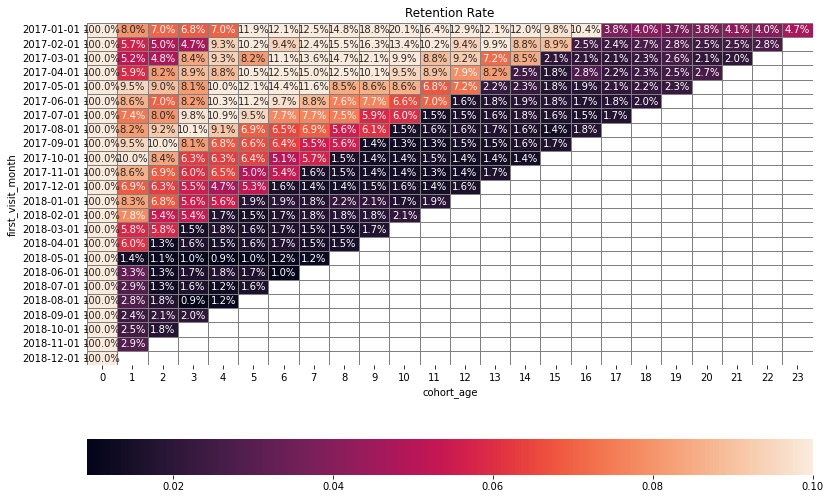

In [141]:
# visualize ratention rate with heatmap

visits_retention_pivot.index=visits_retention_pivot.index.astype(str)
plt.figure(figsize=(13, 9))
sns.heatmap(visits_retention_pivot, annot=True, fmt='.1%', linewidths=1, linecolor='grey',  vmax=0.1, cbar_kws= {'orientation': 'horizontal'} 
            ).set(title = 'Retention Rate')
plt.show()

#### conclution on product analysis

1. the site draws motsly new users, not a lot of visitors come back over time
2. the visits on the site are not very long. it seems visitors can browes around the site fast and find what interests them quite easily.
3. desktop is the dominant device through which visitors access the site. perhaps the inerface is more user friendly than on touch, perhaps the sources from which they enter the site are more widley used on desktop devices.
4. we can defenatly see that some sources attract a lot of traffic in comparisson to other sources. and some sources hardly draw any traffic.

### analyzing the orders table

in the following analyses we'll explore the orders table, by examining when users become customers (not just visit the site, but actualy make orders and generate revenue), how often they make more orders (if any), how big are the orders, and how much revenue thay ganarate.

#### When do people start buying?

in this case we are looking for convertion, i.e. when a user becomes a customer. for this analysis we will find the first order for each user, and compare it with their first activity date (visit), to find out how long it took for each customer (out of the users that ended up making a purchase), and calculate the overall avarage convertion time. we will also calculate what is the convertion rate - what is the percantage of visitors who actualy made orders.

In [142]:
#we already have first_activity_date dataset created erlier

first_activity_date

Uid
1.186350e+13   2018-01-03 17:27:00
4.953710e+13   2018-06-02 15:55:00
2.977290e+14   2017-07-06 18:47:00
3.135780e+14   2017-09-18 22:49:00
3.253210e+14   2017-09-30 14:29:00
                       ...        
1.844620e+19   2017-07-11 10:01:00
1.844630e+19   2018-02-26 10:14:00
1.844640e+19   2017-06-12 20:32:00
1.844660e+19   2017-12-27 13:27:00
1.844670e+19   2017-04-10 16:01:00
Name: first_activity_date, Length: 176796, dtype: datetime64[ns]

In [143]:
#we already have first_order_date dataset created erlier

first_order_date

Uid
3.135780e+14   2018-03-01 21:51:00
1.575280e+15   2017-03-06 10:13:00
2.429010e+15   2017-11-10 18:33:00
2.464370e+15   2018-01-28 15:54:00
2.551850e+15   2017-11-24 10:14:00
                       ...        
1.844230e+19   2018-05-02 19:39:00
1.844510e+19   2017-11-24 09:03:00
1.844540e+19   2017-09-22 23:55:00
1.844560e+19   2018-03-26 22:54:00
1.844620e+19   2017-10-17 10:16:00
Name: first_order_date, Length: 34818, dtype: datetime64[ns]

In [144]:
#merge the 2 subset into 1 dataframe

convertion = pd.merge(first_order_date, first_activity_date, how='left',on=['Uid'])
convertion.head()

,first_order_date,first_activity_date
Uid,,
3.135780e+14,2018-03-01 21:51:00,2017-09-18 22:49:00
1.575280e+15,2017-03-06 10:13:00,2017-03-06 10:13:00
2.429010e+15,2017-11-10 18:33:00,2017-11-10 17:14:00
2.464370e+15,2018-01-28 15:54:00,2018-01-27 20:10:00
2.551850e+15,2017-11-24 10:14:00,2017-11-24 10:14:00


In [145]:
#calculate how many days pased from first visit to first purchase

convertion['conversion_time']=((pd.to_datetime(convertion['first_order_date'])-pd.to_datetime(convertion['first_activity_date']))/np.timedelta64(1,'D')).astype('int')

In [146]:
convertion

,first_order_date,first_activity_date,conversion_time
Uid,,,
3.135780e+14,2018-03-01 21:51:00,2017-09-18 22:49:00,163
1.575280e+15,2017-03-06 10:13:00,2017-03-06 10:13:00,0
2.429010e+15,2017-11-10 18:33:00,2017-11-10 17:14:00,0
2.464370e+15,2018-01-28 15:54:00,2018-01-27 20:10:00,0
2.551850e+15,2017-11-24 10:14:00,2017-11-24 10:14:00,0
...,...,...,...
1.844230e+19,2018-05-02 19:39:00,2018-05-02 19:35:00,0
1.844510e+19,2017-11-24 09:03:00,2017-08-20 13:30:00,95
1.844540e+19,2017-09-22 23:55:00,2017-09-22 23:48:00,0


In [147]:
# let's visualize density of different convertion days

fig = px.histogram(convertion, x="conversion_time",nbins=30, title='density of different convertion days')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [148]:
#to avoid outliers, let's find tha avarage time of convertion with median

convertion['conversion_time'].median()

0.0

In [149]:
#calculate the overall convertion rate from visits (all unique users in df_users) to orders (all unique users in df_orders)

print(' The overall conversion is {:.1%}'.format(df_orders['Uid'].nunique()/df_visits['Uid'].nunique()))

 The overall conversion is 19.7%


there are 2 main observations:
1. for the most part, users that end up making an order, do it during their first visit (or at least at their first visit date). this might indicate that customers (not visitors) visit the site with the purpose of making a purchase (not just visit to browse).
2. only 16% of visitors end up making a purchse.

#### How many orders do they make during a given period of time?

we'll be doing a cohort analysis, by looking for the cumulative amount of orders for cohort per user (by calculating the monthly amount of orders, per cohort, and devide it by the amount of users in each cohort). to do so, we'll divide users into monthly cohorts, based on the first_order_date values created erlier.

In [150]:
#create first order month column

df_orders['first_order_month'] = df_orders['first_order_date'].astype('datetime64[M]')

In [151]:
#create month of order to all orders

df_orders['order_month'] = df_orders['Buy_Ts'].astype('datetime64[M]')

In [152]:
#find age of cohort in every row

df_orders['cohort_age'] = ((pd.to_datetime(df_orders['order_month']) - pd.to_datetime(df_orders['first_order_month'])) / np.timedelta64(1,'M'))\
                                                                        .round().astype('int')

In [153]:
df_orders.head()

,Buy_Ts,Revenue,Uid,first_order_date,order_date,first_source,first_order_month,order_month,cohort_age
0,2017-01-06 00:10:00,17.00,1.032930e+19,2017-01-06 00:10:00,2017-01-06,1,2017-01-01,2017-01-01,0
1,2017-01-06 00:25:00,0.55,1.162730e+19,2017-01-06 00:25:00,2017-01-06,2,2017-01-01,2017-01-01,0
2,2017-01-06 00:27:00,0.37,1.790370e+19,2017-01-06 00:27:00,2017-01-06,2,2017-01-01,2017-01-01,0
3,2017-01-06 00:29:00,0.55,1.610920e+19,2017-01-06 00:29:00,2017-01-06,2,2017-01-01,2017-01-01,0
4,2017-01-06 07:58:00,0.37,1.420060e+19,2017-01-06 07:58:00,2017-01-06,3,2017-01-01,2017-01-01,0


In [154]:
# group the data by cohort and lifetime and find the number of initial amount of users for each cohort for each cohort lifetime

orders_cohorts = (df_orders.groupby(['first_order_month', 'cohort_age'])
    .agg({'Uid': 'nunique'})
    .reset_index())

In [155]:
orders_cohorts = orders_cohorts.rename(columns={'Uid': 'cohort_active_users'}) 

In [156]:
#take a look

orders_cohorts.head()

,first_order_month,cohort_age,cohort_active_users
0,2017-01-01,0,693
1,2017-01-01,1,41
2,2017-01-01,2,29
3,2017-01-01,3,35
4,2017-01-01,4,42


In [157]:
#find the initial number of customers in each cohort (by looking at the 0th week)

initial_customers_count = orders_cohorts[orders_cohorts['cohort_age'] == 0][['first_order_month', 'cohort_active_users']]

In [158]:
#take a look

initial_customers_count

,first_order_month,cohort_active_users
0,2017-01-01,693
24,2017-02-01,641
47,2017-03-01,704
69,2017-04-01,701
90,2017-05-01,785
110,2017-06-01,1793
129,2017-07-01,1996
147,2017-08-01,1625
164,2017-09-01,2293
180,2017-10-01,2678


In [159]:
#raname Uid column

initial_customers_count = initial_customers_count.rename(columns={'cohort_active_users': 'cohort_size'}) 

In [160]:
initial_customers_count

,first_order_month,cohort_size
0,2017-01-01,693
24,2017-02-01,641
47,2017-03-01,704
69,2017-04-01,701
90,2017-05-01,785
110,2017-06-01,1793
129,2017-07-01,1996
147,2017-08-01,1625
164,2017-09-01,2293
180,2017-10-01,2678


In [161]:
# add cohort_users column to cohorts dataset

orders_cohorts = orders_cohorts.merge(initial_customers_count, on='first_order_month') 

In [162]:
orders_cohorts.head()

,first_order_month,cohort_age,cohort_active_users,cohort_size
0,2017-01-01,0,693,693
1,2017-01-01,1,41,693
2,2017-01-01,2,29,693
3,2017-01-01,3,35,693
4,2017-01-01,4,42,693


In [163]:
#calculating number of orders for cohort and month
orders_per_cohort=df_orders.groupby(['first_order_month','order_month'])['Revenue'].count().reset_index()
orders_per_cohort.rename(columns={"Revenue": "order_count"}, inplace=True)

orders_per_cohort.head()

,first_order_month,order_month,order_count
0,2017-01-01,2017-01-01,767
1,2017-01-01,2017-02-01,65
2,2017-01-01,2017-03-01,56
3,2017-01-01,2017-04-01,71
4,2017-01-01,2017-05-01,78


In [164]:
#add order_month to orders_cohorts

order_month = orders_per_cohort["order_month"]
orders_cohorts = orders_cohorts.join(order_month)

In [165]:
#orders_cohorts = orders_cohorts.join(order_month)

In [166]:
#add order_count to orders_cohorts

order_count = orders_per_cohort["order_count"]
orders_cohorts = orders_cohorts.join(order_count)

In [167]:
#calculate orders+per_user

orders_cohorts['orders_per_user']=orders_cohorts['order_count']/orders_cohorts['cohort_size']

In [168]:
#take a look

orders_cohorts

,first_order_month,cohort_age,cohort_active_users,cohort_size,order_month,order_count,orders_per_user
0,2017-01-01,0,693,693,2017-01-01,767,1.106782
1,2017-01-01,1,41,693,2017-02-01,65,0.093795
2,2017-01-01,2,29,693,2017-03-01,56,0.080808
3,2017-01-01,3,35,693,2017-04-01,71,0.102453
4,2017-01-01,4,42,693,2017-05-01,78,0.112554
...,...,...,...,...,...,...,...
295,2018-10-01,1,3,428,2018-11-01,4,0.009346
296,2018-10-01,2,3,428,2018-12-01,3,0.007009
297,2018-11-01,0,407,407,2018-11-01,424,1.041769
298,2018-11-01,1,6,407,2018-12-01,7,0.017199


In [169]:
# create a pivot table with cumsum method to express cumulative amount of orders, per user, for each cohort_age

cohort_cumulative_orders = orders_cohorts.pivot_table(
    index='first_order_month', 
    columns='cohort_age', 
    values='orders_per_user', 
    aggfunc='sum'
).cumsum(axis=1)

cohort_cumulative_orders.round(2).fillna('')

cohort_age,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
first_order_month,,,,,,,,,,,,,,,,,,,,,
2017-01-01,1.11,1.2,1.28,1.38,1.5,1.68,1.92,2.16,2.53,2.86,...,4.57,4.72,4.91,4.95,5.01,5.04,5.1,5.14,5.19,5.25
2017-02-01,1.07,1.11,1.14,1.17,1.22,1.26,1.35,1.41,1.58,1.71,...,1.93,1.96,1.98,1.98,1.99,1.99,2.0,2.0,2.01,
2017-03-01,1.04,1.07,1.1,1.15,1.2,1.24,1.3,1.39,1.47,1.55,...,1.78,1.79,1.81,1.82,1.83,1.84,1.85,1.87,,
2017-04-01,1.06,1.12,1.14,1.19,1.24,1.31,1.38,1.48,1.55,1.61,...,1.82,1.82,1.83,1.83,1.84,1.85,1.86,,,
2017-05-01,1.08,1.13,1.18,1.21,1.25,1.32,1.41,1.46,1.5,1.54,...,1.63,1.64,1.64,1.65,1.65,1.66,,,,
2017-06-01,1.09,1.14,1.17,1.2,1.25,1.31,1.36,1.38,1.42,1.45,...,1.51,1.52,1.52,1.53,1.53,,,,,
2017-07-01,1.09,1.14,1.17,1.2,1.26,1.31,1.34,1.38,1.42,1.44,...,1.51,1.51,1.52,1.53,,,,,,
2017-08-01,1.08,1.12,1.17,1.22,1.26,1.29,1.32,1.34,1.37,1.4,...,1.43,1.43,1.43,,,,,,,
2017-09-01,1.10,1.15,1.2,1.24,1.26,1.3,1.33,1.34,1.38,1.38,...,1.41,1.41,,,,,,,,


the initial amount of orders_per_user in all cohorts is similar, from 1 to 1.18, although some cohorts are better then others in  cumulative purchases over time, the avarage amount of order per user still remains low (first cohort has the highst cumulative amount of orders, per user, but it is not a high number). in general it seems that customers purchase from the site no more than twice a year.

#### what is the average purchase size?

we'll be calculating the avarage order size (using each order's revenue), in a similar way to the previuos analysis, i.e. we'll be using cohort analysis.

before we start the analysis we'll calculate overall anarage order size (with mean and median), and calculate and visualize daily and monthly order size.

In [170]:
#calculate the overall avarage order size, using mean

print(' The overall mean individual order size is {}'.format(df_orders['Revenue'].mean().round(2)))

 The overall mean individual order size is 5.0


In [171]:
#calculate the overall avarage order size, using median

print(' The overall median individual order size is {}'.format(df_orders['Revenue'].median().round(2)))

 The overall median individual order size is 2.5


In [172]:
#first, let's calculate and visualize the avarage of the daily order using median (to avoid aoutliers)

avg_daily = df_orders.groupby(['order_date'])['Revenue'].median().reset_index()
fig = px.line(avg_daily,x="order_date", y="Revenue",title='avarage revenue of daily orders')
fig.add_hline(y=avg_daily['Revenue'].mean(),line_dash="dash", line_color="purple", 
              annotation_text="daily mean order size - {}".format(avg_daily['Revenue'].mean().round(1)),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [173]:
#first, let's calculate and visualize the avarage of the daily order using median (to avoid aoutliers)

avg_monthly = df_orders.groupby(['order_month'])['Revenue'].median().reset_index()
fig = px.line(avg_monthly,x="order_month", y="Revenue",title='avarage revenue of monthly orders')
fig.add_hline(y=avg_monthly['Revenue'].mean(),line_dash="dash", line_color="purple", 
              annotation_text="monthly mean order size - {}".format(avg_monthly['Revenue'].mean().round(1)),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

when looking on the daily avarage of order size (revenue), we can see that even thoght there is a lot of fluctuation, the peaks and lows are not severe, and for the most part circle around the overall avarage. but we do have a few high peaks (mostly during the summer months, and one stand out in nevemver), and a few low peaks (about 7) that scatter around the entire year.

in the monthly graph there are fewer flactuations. there are 2 peaks, both around summer months (also corralate to the daily graph where we saw more high peaks in summer months).

the high picks are maybe related to seasonality:
- summer vacations when kids don't have school, families spend time together, and the size of the order is reflected in that.
- in november people are planning ahead to the upcoming holidays, when again, the whole family is on holiday.

In [174]:
# calculate the monthly avarge revenue for each cohort

avg_cohort=df_orders.groupby(['first_order_month','order_month'])['Revenue'].mean().reset_index()
#avg_cohort['age_month'] = ((avg_cohort['month'] - avg_cohort['first_order_month']) / np.timedelta64(1,'M')).round()
avg_cohort.head()

,first_order_month,order_month,Revenue
0,2017-01-01,2017-01-01,4.565059
1,2017-01-01,2017-02-01,3.628000
2,2017-01-01,2017-03-01,6.350000
3,2017-01-01,2017-04-01,11.859718
4,2017-01-01,2017-05-01,10.990513


In [175]:
#add the column to the orders_cohorts we previously created

orders_cohorts=orders_cohorts.merge(avg_cohort,on=['first_order_month', 'order_month'])

In [176]:
#remane the column

orders_cohorts.rename(columns={"Revenue": "avg_revenue"}, inplace=True)

In [177]:
orders_cohorts

,first_order_month,cohort_age,cohort_active_users,cohort_size,order_month,order_count,orders_per_user,avg_revenue
0,2017-01-01,0,693,693,2017-01-01,767,1.106782,4.565059
1,2017-01-01,1,41,693,2017-02-01,65,0.093795,3.628000
2,2017-01-01,2,29,693,2017-03-01,56,0.080808,6.350000
3,2017-01-01,3,35,693,2017-04-01,71,0.102453,11.859718
4,2017-01-01,4,42,693,2017-05-01,78,0.112554,10.990513
...,...,...,...,...,...,...,...,...
295,2018-10-01,1,3,428,2018-11-01,4,0.009346,5.730000
296,2018-10-01,2,3,428,2018-12-01,3,0.007009,4.410000
297,2018-11-01,0,407,407,2018-11-01,424,1.041769,3.922854
298,2018-11-01,1,6,407,2018-12-01,7,0.017199,6.997143


In [178]:
# create a pivot table with to express avarage order size, per cohort, for each cohort_age

cohort_avg_orders = orders_cohorts.pivot_table(
    index='first_order_month', 
    columns='cohort_age', 
    values='avg_revenue', 
    aggfunc='mean'
)

cohort_avg_orders.round(2).fillna('')

cohort_age,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
first_order_month,,,,,,,,,,,,,,,,,,,,,
2017-01-01,4.57,3.63,6.35,11.86,10.99,8.02,6.25,8.83,10.39,25.73,...,8.42,14.88,8.49,14.37,20.24,7.24,10.15,10.04,4.85,6.75
2017-02-01,4.17,8.83,7.14,2.03,4.96,4.78,4.8,6.37,11.15,6.73,...,8.06,6.7,4.2,5.2,2.22,2.87,2.59,4.52,2.35,
2017-03-01,3.79,4.06,14.21,3.72,5.95,4.27,7.13,7.72,4.64,5.5,...,4.33,3.48,5.62,3.94,6.44,7.78,3.64,3.78,,
2017-04-01,3.71,5.97,3.37,6.54,9.38,11.68,12.28,5.93,7.09,13.01,...,15.28,6.23,6.93,2.75,31.72,4.77,8.6,,,
2017-05-01,3.79,4.47,5.89,4.85,4.1,4.59,5.09,3.89,5.83,5.24,...,2.66,13.44,5.27,5.35,3.16,1.18,,,,
2017-06-01,4.42,6.21,5.48,4.48,6.91,4.36,4.74,6.39,8.39,3.82,...,3.79,2.07,3.08,4.25,2.71,,,,,
2017-07-01,4.67,3.91,9.29,3.77,4.16,4.06,4.09,4.34,3.88,8.6,...,3.45,3.56,3.54,5.28,,,,,,
2017-08-01,4.48,6.36,5.82,5.97,5.63,4.57,5.04,5.37,7.08,6.4,...,4.05,9.5,4.62,,,,,,,
2017-09-01,4.53,5.53,6.98,7.09,10.05,6.2,4.18,2.57,3.79,4.12,...,6.73,2.74,,,,,,,,


for the most part, the avarage monthly revenue of all cohorts is roughly around 3-6. having said that, althogh some cohorts don't stray far from those sizes, we can see a few succsesful cohorts, that exceed that size:
- june cohort has some modaratly succesful months, mainly age 3 (september), 9 (march) and 12 (april)
- december cohort has succesfull months early in it's life, from age 2 (february) onwards
- september cohort is the most succesfull overall from age 1 (october) onwards, but especially at age 3 (december).

#### how much money do they bring? (LTV)

to answer this question we will further use the data and subset created in previuose cohort analysis.
this time we need to find the LTV - the customer's lifetime value, i.e. the total amount of money a customer brings to the company on average by making purchases. When calculating LTV, usually, we need to consider the GP (gross profit) from a customer per period. for the purpose of this analysis, we will consider the dta in the revenue column (in the orders table) as our GP.
to calculate LTV we'll divide the cohort's revenue for each month, by the total number of users in each cohort. We'll visualize the cohorts by pivot table with heatmap.

In [179]:
#calculate the total revenue per cohort in each month
ltv_cohort=df_orders.groupby(['first_order_month','order_month'])['Revenue'].sum().reset_index()
ltv_cohort.rename(columns={"Revenue": "total_revenue"}, inplace=True)
ltv_cohort

,first_order_month,order_month,total_revenue
0,2017-01-01,2017-01-01,3501.40
1,2017-01-01,2017-02-01,235.82
2,2017-01-01,2017-03-01,355.60
3,2017-01-01,2017-04-01,842.04
4,2017-01-01,2017-05-01,857.26
...,...,...,...
295,2018-10-01,2018-11-01,22.92
296,2018-10-01,2018-12-01,13.23
297,2018-11-01,2018-11-01,1663.29
298,2018-11-01,2018-12-01,48.98


In [180]:
#merge with the orders_cohorts perviously created
orders_cohorts=orders_cohorts.merge(ltv_cohort,on=['first_order_month', 'order_month'])
orders_cohorts

,first_order_month,cohort_age,cohort_active_users,cohort_size,order_month,order_count,orders_per_user,avg_revenue,total_revenue
0,2017-01-01,0,693,693,2017-01-01,767,1.106782,4.565059,3501.40
1,2017-01-01,1,41,693,2017-02-01,65,0.093795,3.628000,235.82
2,2017-01-01,2,29,693,2017-03-01,56,0.080808,6.350000,355.60
3,2017-01-01,3,35,693,2017-04-01,71,0.102453,11.859718,842.04
4,2017-01-01,4,42,693,2017-05-01,78,0.112554,10.990513,857.26
...,...,...,...,...,...,...,...,...,...
295,2018-10-01,1,3,428,2018-11-01,4,0.009346,5.730000,22.92
296,2018-10-01,2,3,428,2018-12-01,3,0.007009,4.410000,13.23
297,2018-11-01,0,407,407,2018-11-01,424,1.041769,3.922854,1663.29
298,2018-11-01,1,6,407,2018-12-01,7,0.017199,6.997143,48.98


In [181]:
#find our LTV

orders_cohorts['ltv']=orders_cohorts['total_revenue']/orders_cohorts['cohort_size']
orders_cohorts

,first_order_month,cohort_age,cohort_active_users,cohort_size,order_month,order_count,orders_per_user,avg_revenue,total_revenue,ltv
0,2017-01-01,0,693,693,2017-01-01,767,1.106782,4.565059,3501.40,5.052525
1,2017-01-01,1,41,693,2017-02-01,65,0.093795,3.628000,235.82,0.340289
2,2017-01-01,2,29,693,2017-03-01,56,0.080808,6.350000,355.60,0.513131
3,2017-01-01,3,35,693,2017-04-01,71,0.102453,11.859718,842.04,1.215065
4,2017-01-01,4,42,693,2017-05-01,78,0.112554,10.990513,857.26,1.237027
...,...,...,...,...,...,...,...,...,...,...
295,2018-10-01,1,3,428,2018-11-01,4,0.009346,5.730000,22.92,0.053551
296,2018-10-01,2,3,428,2018-12-01,3,0.007009,4.410000,13.23,0.030911
297,2018-11-01,0,407,407,2018-11-01,424,1.041769,3.922854,1663.29,4.086708
298,2018-11-01,1,6,407,2018-12-01,7,0.017199,6.997143,48.98,0.120344


In [182]:
# create a pivot table with cumsum method to express cumulative orders' sum per user (i.e. LTV), for each cohort_age

orders_ltv_cohort=orders_cohorts.pivot_table(
    index='first_order_month', 
    columns='cohort_age', 
    values='ltv', 
    aggfunc='sum'
).cumsum(axis=1)

In [183]:
#take a look

orders_ltv_cohort

cohort_age,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
first_order_month,,,,,,,,,,,,,,,,,,,,,
2017-01-01,5.052525,5.392814,5.905945,7.121010,8.358038,9.816797,11.349683,13.451443,17.260476,25.837201,...,43.063882,45.383550,46.964733,47.565873,48.792626,49.022525,49.593853,50.042900,50.273882,50.683001
2017-02-01,4.457566,4.815772,5.049626,5.112824,5.360281,5.546833,5.943885,6.381451,8.207441,9.088877,...,10.289844,10.519735,10.578721,10.594930,10.608768,10.622215,10.642418,10.670624,10.681638,NaN
2017-03-01,3.940000,4.072741,4.516662,4.685554,4.981548,5.163707,5.548438,6.261307,6.650142,7.056335,...,8.331151,8.355866,8.459716,8.498849,8.562926,8.684545,8.725952,8.795781,NaN,NaN
2017-04-01,3.935621,4.267646,4.358902,4.666648,5.121412,5.987532,6.793623,7.385892,7.901612,8.718488,...,10.124394,10.151070,10.210357,10.222126,10.357860,10.432682,10.481783,NaN,NaN,NaN
2017-05-01,4.077592,4.322497,4.592803,4.728828,4.916841,5.220866,5.675057,5.888382,6.089032,6.302611,...,7.064191,7.098433,7.125287,7.159376,7.171465,7.178968,NaN,NaN,NaN,NaN
2017-06-01,4.808076,5.109515,5.268383,5.440859,5.737764,6.024529,6.233313,6.379470,6.693017,6.814451,...,7.122593,7.134127,7.146152,7.169844,7.184969,NaN,NaN,NaN,NaN,NaN
2017-07-01,5.115837,5.274369,5.572109,5.711804,5.945240,6.144684,6.277836,6.445135,6.583041,6.798477,...,7.116433,7.132500,7.152024,7.212916,NaN,NaN,NaN,NaN,NaN,NaN
2017-08-01,4.845329,5.127126,5.381569,5.668271,5.914265,6.043569,6.189471,6.325028,6.495003,6.715415,...,6.838406,6.861797,6.881717,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-09-01,4.992590,5.270144,5.605098,5.858674,6.126119,6.334427,6.460292,6.504086,6.636459,6.645451,...,6.753419,6.764169,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


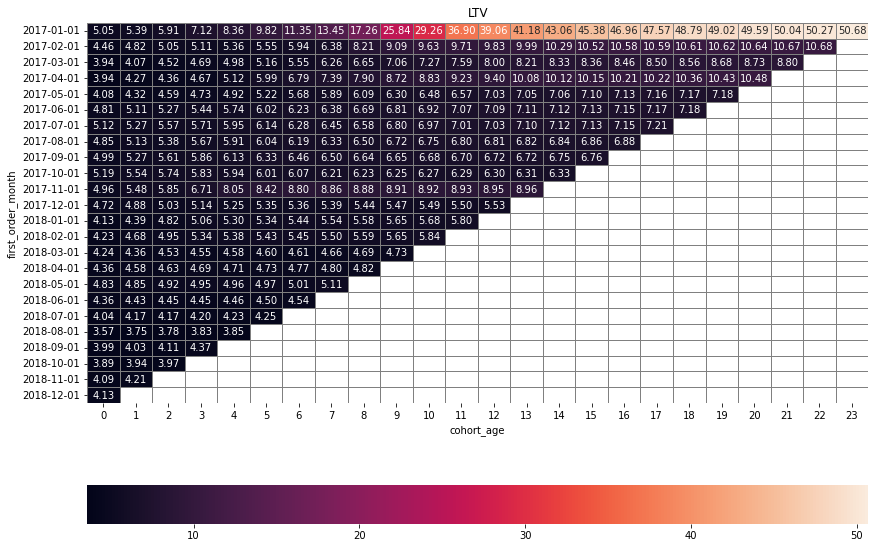

In [184]:
#visualize it

orders_ltv_cohort.index=orders_ltv_cohort.index.astype(str)
fig, ax = plt.subplots(figsize=(14,10))         
sns.heatmap(orders_ltv_cohort, annot=True, fmt='.2f', linewidths=1, linecolor='grey', cbar_kws= {'orientation': 'horizontal'} 
            ).set(title ='LTV')
plt.show()

in the previouse analysis we found the monthly order size for the entire cohort, and in this one the avarage order size of each cohort, per user.

we can see that the 3 succeful from previouse analysis, are reletevly succesful in this analysis as well, with december as the least succesful of the 3, than the june cohort, and september cohort is the most succesful of the 3, and the most succesful out of all the cohorts in this analysis.
we can see that july and august cohors are reletevly succesfull.

#### conclution on sales analysis

1. less than a fifth of visitors become customers (make purchases\orders). those who do, seem to enter the site already with the purpose of making an order, since most customers make their first purchase on their first visit.
2. on avarage, most customer will make between 1 and 2 orders, in an entire year.
3. when deviding users into cohorts, it is possible to distinguish which are the succesful cohorts.
4. we can notice seasonality when it comes to revenue:
- the cohorts that belong to last months of the year (roughly from july to november) are more sucssesful in their first month (age 0).
- some of the summer cohorts are the most succesful out of all the cohorts, and the size of their orders rise when these cohorts reach the winter months.
- during the summer families spent time together, and it makes sense that there are orders of bigger size.
- it also makes sense making big purchases in october to december, maybe ordering in advance tickets for events\shows taking place during the december holidays.
- it is also reasonable to assume that during summer and during december holidays, there are more offerings availiable on the site since those are probably times of the year when there is a lot of offering availiable for the demand of poeple and families.

### analyzing the marketing table

in the following analyses we'll explore the costs table, by examining how much money was spent on marketing (overall/per source/over time), how much did customer acquisition from each of the sources cost, and if these investments were worthwhile.

#### How much money was spent? Overall/per source/over time

In [185]:
# calculate the overall marketing costs

print('Total overall marketing cost is {}'.format(df_costs['costs'].sum()))

Total overall marketing cost is 329131.62


##### marketing costs over time

we'll calculate and visualize marketing cost over time once by date, and once by month.

In [186]:
# calculating marketing costs by date

costs_per_date = df_costs.groupby(['dt'])['costs'].sum().reset_index()

costs_per_date.head()

,dt,costs
0,01/01/2018,858.59
1,01/02/2018,1378.76
2,01/03/2018,1437.28
3,01/05/2018,597.06
4,01/06/2017,735.26


In [187]:
#visualizing marketing costs over time, by date

fig = px.line(costs_per_date,x="dt", y="costs",title='marketing costs over time, by date')
fig.add_hline(y=costs_per_date['costs'].mean(),line_dash="dash", line_color="purple", annotation_text="average costs over time - {}".format(costs_per_date['costs'].mean().round(2)),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [188]:
# calculating marketing costs by month

costs_per_month = df_costs.groupby(['month_of_expense'])['costs'].sum().reset_index()

costs_per_month

,month_of_expense,costs
0,2017-01-01,5496.85
1,2017-02-01,5590.49
2,2017-03-01,5940.09
3,2017-04-01,6177.86
4,2017-05-01,6810.90
5,2017-06-01,16098.43
6,2017-07-01,17761.72
7,2017-08-01,16417.80
8,2017-09-01,21960.16
9,2017-10-01,27361.31


In [189]:
#visualizing marketing costs over time, by date

fig = px.line(costs_per_month,x="month_of_expense", y="costs",title='marketing costs over time, by month')
fig.add_hline(y=costs_per_month['costs'].mean(),line_dash="dash", line_color="purple", annotation_text="average costs over time - {}".format(costs_per_month['costs'].mean().round(2)),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

the dynamics and factuations of the marketing costs over time, by date, is very similar to the those of the DAU analysis we performed erlier on the visits table.
the fact that the marketing investment is mirrored in the amount of visitors might indicate that, at the very least, as far as attracting visitors, the marketing is working.

when calculating by month there are obviousle less flactuations, but the overall trend is the same as in the daily graph.

obviously visitors are not necessarily customers, so further analysis is required in order to determine whether marketing is attracting customersas well (not just visitors).

##### overall marketing costs per source

in this analysis we'll be calculating and visualizing the overall costs of marketing, per source. we'll see which are the sources that had the highest marketing investment overall.

In [190]:
# let's see how many differenr sources we have in this table

df_costs['source_id'].unique()

array([ 1,  2,  3,  4,  5,  9, 10], dtype=int64)

In [191]:
#calculating marketing costs per source

costs_per_source=df_costs.groupby(['source_id'])['costs'].sum().reset_index()

costs_per_source

,source_id,costs
0,1,20833.27
1,2,42806.04
2,3,141321.63
3,4,61073.60
4,5,51757.10
5,9,5517.49
6,10,5822.49


In [192]:
#plot a graph cost per source, and the avarage for all sources

fig = px.bar(costs_per_source, x='source_id', y='costs', width=800, height=400, title='cost per source')
fig.update_xaxes(type='category')
fig.add_hline(y=costs_per_source['costs'].mean(),line_dash="dash", line_color="purple", annotation_text="average cost - {}".format(costs_per_source['costs'].mean().round()),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

when looking at overall marketing costs, source 3 has the highst investmant, by far (more than twice the amount than source 4, which is the second highst). sources 4,5 and 2 are close to each other, and to the avarage.
sources 1, 10 and 9 have the lowest investmant costs.

##### marketing costs per source, over time

in this analysis we'll be calculating and visualizing the daily costs of marketing, per source (by date and by month)

In [193]:
# calculating marketing costs by date

costs_per_date_source = df_costs.sort_values(by=['dt','source_id'])
costs_per_date_source.head()

,source_id,dt,costs,month_of_expense
214,1,01/01/2018,82.86,2018-01-01
577,2,01/01/2018,113.13,2018-01-01
940,3,01/01/2018,364.64,2018-01-01
1303,4,01/01/2018,92.45,2018-01-01
1666,5,01/01/2018,149.29,2018-01-01


In [194]:
# visualizing costs, per source, over time, by date

fig = px.line(costs_per_date_source, x="dt", y="costs", color='source_id', width=1000, height=700,
              title='marketing costs over time, per source, by date')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [195]:
# calculating marketing costs by date

costs_per_month_source = df_costs.groupby(['month_of_expense', 'source_id'])['costs'].sum().reset_index().sort_values(by=['month_of_expense','source_id'])
costs_per_month_source.head()

,month_of_expense,source_id,costs
0,2017-01-01,1,347.20
1,2017-01-01,2,832.34
2,2017-01-01,3,2553.64
3,2017-01-01,4,687.74
4,2017-01-01,5,878.67


In [196]:
# visualizing costs, per source, over time, by date

fig = px.line(costs_per_month_source, x="month_of_expense", y="costs", color='source_id', width=1000, height=700,
              title='marketing costs over time, per source, by month')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

the dynamics and flactuation in the 'marketing costs over time, per source, by date' graph are very similat to those of the 'marketing costs over time' graph we visualized in an erlier analysis.

we can see that even when looking at markering costs over time, not just overall total costs per source, the variation between the sources remains the same: source 3 has the highst investmant, than 4, 5, 2 and 1, and 10 and 9 have the lowest investmant costs by far.

it also seems that despite the fact that costs of different sources vary from source to source, the dynamics and flactuation of all sources, for the most part, are the similar. this might indicate that the ratio or the portion of each source out of the total daily marketing buget stays the same (for the most part), even when the total budget\cost rises or decreases over time.


when calculating by month there are obviousle less flactuations, but the overall trend is the same as in the daily graph.

#### How much did customer acquisition, from each of the sources, cost?

in this analysis we'll be calculating the CAC - customer acquisition cost, i.e how much does it cost the company to attract customers (users that makes actual orders\purchases and not just visits).

##### monthly cost of aquisition (CAC)

in this analysis, we'll first group the costs\expenses by month, calculate the number of customers for each month, and calculate the ratio between mothly expenses to monthly customers i.e. the monthly CAC.

In [197]:
#calculate total_monthly_cost

total_monthly_cost = df_costs.groupby(['month_of_expense'])['costs'].sum().reset_index()

total_monthly_cost

,month_of_expense,costs
0,2017-01-01,5496.85
1,2017-02-01,5590.49
2,2017-03-01,5940.09
3,2017-04-01,6177.86
4,2017-05-01,6810.90
5,2017-06-01,16098.43
6,2017-07-01,17761.72
7,2017-08-01,16417.80
8,2017-09-01,21960.16
9,2017-10-01,27361.31


In [198]:
#find the amount of customers_per_month from df_orders using first_order_month (and not order_month), since this kind of
# analysis focuses on new customers (i.e. the original order of each customer) and not on returning customers.

customers_per_month = df_orders.groupby(['first_order_month'])['Uid'].nunique().reset_index()

In [199]:
#rename the columns

customers_per_month.columns=['month_of_expense','customers_per_month']

customers_per_month

,month_of_expense,customers_per_month
0,2017-01-01,693
1,2017-02-01,641
2,2017-03-01,704
3,2017-04-01,701
4,2017-05-01,785
5,2017-06-01,1793
6,2017-07-01,1996
7,2017-08-01,1625
8,2017-09-01,2293
9,2017-10-01,2678


In [200]:
#merge the 2 datasets

CAC_per_month = total_monthly_cost.merge(customers_per_month,how='left',on=['month_of_expense'])

In [201]:
#calculate the general overall monthly CAC

CAC_per_month['CAC'] = CAC_per_month['costs']/CAC_per_month['customers_per_month']
CAC_per_month

,month_of_expense,costs,customers_per_month,CAC
0,2017-01-01,5496.85,693,7.931962
1,2017-02-01,5590.49,641,8.721513
2,2017-03-01,5940.09,704,8.437628
3,2017-04-01,6177.86,701,8.812924
4,2017-05-01,6810.90,785,8.676306
5,2017-06-01,16098.43,1793,8.978489
6,2017-07-01,17761.72,1996,8.898657
7,2017-08-01,16417.80,1625,10.103262
8,2017-09-01,21960.16,2293,9.577043
9,2017-10-01,27361.31,2678,10.217069


In [202]:
#visualze the monthly CAC, and add the avarage of the monthly CAC

fig = px.line(CAC_per_month, x="month_of_expense", y="CAC", title='Monthly CAC')
fig.add_hline(y=CAC_per_month['CAC'].mean(),line_dash="dash", line_color="purple", annotation_text="average of monthly CAC - {}".format(CAC_per_month['CAC'].mean().round(2)),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

there is not a lot of variation in the CAC, since for the most part, there are not a lot of flactuations, and it revovles around the avarage. we only have 2 distinct peaks: a high peak in august, and a low peak in late may.

##### monthly cost of aquisition (CAC), per source

in this analysis, we'll need to find the the original source of the customer, since users\customers can come from different sources, in different visits. but we need to find which was the source that attracted each customer to begin with.
the source of each customer is found in the df_visits (where we find all users, not only those we made orders).

and than finaly, we'll calculate the CAC by dividing the monthly costs by the number of customers per month, per sources.

In [203]:
#chech if users have more than one source, if they do, we'll need to use the first source for each user in the analysis

df_visits.groupby(['Uid'])['Source_Id'].nunique().reset_index().query('Source_Id>1')

,Uid,Source_Id
16,1.260660e+15,2
37,2.471250e+15,2
40,2.892680e+15,3
52,3.605150e+15,3
65,4.735760e+15,2
...,...,...
176789,1.844600e+19,2
176790,1.844610e+19,3
176791,1.844620e+19,4
176793,1.844640e+19,2


In [204]:
#calculate monthly cost per source

source_monthly_cost = df_costs.groupby(['month_of_expense','source_id'])['costs'].sum().reset_index()

source_monthly_cost.head()

,month_of_expense,source_id,costs
0,2017-01-01,1,347.20
1,2017-01-01,2,832.34
2,2017-01-01,3,2553.64
3,2017-01-01,4,687.74
4,2017-01-01,5,878.67


In [205]:
# find monthly users who made orders, per first source

source_monthly_customers = df_orders.groupby(['first_order_month','first_source'])['Uid'].nunique().reset_index()

In [206]:
source_monthly_customers

,first_order_month,first_source,Uid
0,2017-01-01,1,94
1,2017-01-01,2,107
2,2017-01-01,3,169
3,2017-01-01,4,143
4,2017-01-01,5,150
...,...,...,...
163,2018-12-01,3,116
164,2018-12-01,4,126
165,2018-12-01,5,84
166,2018-12-01,9,17


In [207]:
#rename columns

source_monthly_customers.columns=['month_of_expense','source_id','customers']
source_monthly_customers.head()

,month_of_expense,source_id,customers
0,2017-01-01,1,94
1,2017-01-01,2,107
2,2017-01-01,3,169
3,2017-01-01,4,143
4,2017-01-01,5,150


In [208]:
# merge source_monthly_customers with source_monthly_cost

source_CAC_per_month = source_monthly_cost.merge(source_monthly_customers,how='left',on=['month_of_expense','source_id'])

In [209]:
source_CAC_per_month

,month_of_expense,source_id,costs,customers
0,2017-01-01,1,347.20,94
1,2017-01-01,2,832.34,107
2,2017-01-01,3,2553.64,169
3,2017-01-01,4,687.74,143
4,2017-01-01,5,878.67,150
...,...,...,...,...
163,2018-12-01,3,2082.85,116
164,2018-12-01,4,806.33,126
165,2018-12-01,5,784.59,84
166,2018-12-01,9,71.17,17


In [210]:
#calculate monthly CAC, per source

source_CAC_per_month['CAC']=source_CAC_per_month['costs']/source_CAC_per_month['customers']

source_CAC_per_month.head()

,month_of_expense,source_id,costs,customers,CAC
0,2017-01-01,1,347.20,94,3.693617
1,2017-01-01,2,832.34,107,7.778879
2,2017-01-01,3,2553.64,169,15.110296
3,2017-01-01,4,687.74,143,4.809371
4,2017-01-01,5,878.67,150,5.857800


In [211]:
#plotting cac dynamics
fig = px.line(source_CAC_per_month, x="month_of_expense", y="CAC",color='source_id',title='CAC')
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

In [212]:
overall_avg_CAC = source_CAC_per_month.groupby(['source_id'])['CAC'].mean().reset_index()

overall_avg_CAC.rename(columns={"CAC": "source_avg_CAC"}, inplace=True)

overall_avg_CAC

,source_id,source_avg_CAC
0,1,7.625978
1,2,12.986884
2,3,15.479968
3,4,6.852410
4,5,7.834891
5,9,5.291399
6,10,5.666768


dau and cost per day (which we calculated and visualized erlier) are simmilar, they fluctuate in the same fashion (sincronized), so there is no suprise that the ratio between them is stable. the ration between them is the CAC, so that is why the CAC is reletevly straight and horizontal. it makes sence that when the highs and lows in dau is related to the highs and lows in cost than the CAC stays reletvly the same (as we see from the visualization of all of them).

untill now source 3 stood out as having the highst costs. in the CAC analysis we can see that source 2 has very similar CAC to source 3. this indicates, that even thoght in comparison to other sources, it is not very "expensive", it atrracts a reletevly lower amount of customers. so the cost of aquisition of this source is high.

all other sources (1, 4, 5, 9 and 10) have an overall stable CAC and are overall close to each other.

#### how worthwhile where the investments? (ROI)

in this analysis we'll be calculating ROI - return on investment.
generaly, ROI is the ratio between revenue and costs, so to calculate it, in this analysis, we need to to divide LTV by CAC.
we'll calculate and visualize ROI per month to find the best cohort, and ROI per source, to find the most profitable source.

##### ROI per month

we've already calculated CAC and LTV by month, but in different parts of the project, so we need to merge previouse datasets into one, as the initial steps of this analysis. then calculate and visualize ROI per month

In [213]:
# make a subset of CAC_per_month (previously created) with the needed columns

monthly_CAC = CAC_per_month[['month_of_expense','CAC']]

In [214]:
#rename the columns

monthly_CAC.rename(columns={"month_of_expense": "first_order_month"}, inplace=True)
monthly_CAC.head()

,first_order_month,CAC
0,2017-01-01,7.931962
1,2017-02-01,8.721513
2,2017-03-01,8.437628
3,2017-04-01,8.812924
4,2017-05-01,8.676306


In [215]:
# make a subset of orders_cohorts (previously created) with the needed columns

monthly_ltv = orders_cohorts[['first_order_month','order_month','cohort_age', 'ltv']]
monthly_ltv

,first_order_month,order_month,cohort_age,ltv
0,2017-01-01,2017-01-01,0,5.052525
1,2017-01-01,2017-02-01,1,0.340289
2,2017-01-01,2017-03-01,2,0.513131
3,2017-01-01,2017-04-01,3,1.215065
4,2017-01-01,2017-05-01,4,1.237027
...,...,...,...,...
295,2018-10-01,2018-11-01,1,0.053551
296,2018-10-01,2018-12-01,2,0.030911
297,2018-11-01,2018-11-01,0,4.086708
298,2018-11-01,2018-12-01,1,0.120344


In [216]:
#merge with ltv_cohort (previously created)

ROI_cohort = monthly_ltv.merge(monthly_CAC,on=['first_order_month'],how='left')
ROI_cohort.head()

,first_order_month,order_month,cohort_age,ltv,CAC
0,2017-01-01,2017-01-01,0,5.052525,7.931962
1,2017-01-01,2017-02-01,1,0.340289,7.931962
2,2017-01-01,2017-03-01,2,0.513131,7.931962
3,2017-01-01,2017-04-01,3,1.215065,7.931962
4,2017-01-01,2017-05-01,4,1.237027,7.931962


In [217]:
#calculate ROI

ROI_cohort['ROI']=ROI_cohort['ltv']/ROI_cohort['CAC']
ROI_cohort.head()

,first_order_month,order_month,cohort_age,ltv,CAC,ROI
0,2017-01-01,2017-01-01,0,5.052525,7.931962,0.636983
1,2017-01-01,2017-02-01,1,0.340289,7.931962,0.042901
2,2017-01-01,2017-03-01,2,0.513131,7.931962,0.064692
3,2017-01-01,2017-04-01,3,1.215065,7.931962,0.153186
4,2017-01-01,2017-05-01,4,1.237027,7.931962,0.155955


In [218]:
# visualize in pivot table

pivot_ROI = ROI_cohort.pivot_table(
    index='first_order_month', columns='cohort_age', values='ROI', aggfunc='mean'
).cumsum(axis=1).round(2) 
pivot_ROI

cohort_age,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
first_order_month,,,,,,,,,,,,,,,,,,,,,
2017-01-01,0.64,0.68,0.74,0.90,1.05,1.24,1.43,1.70,2.18,3.26,...,5.43,5.72,5.92,6.00,6.15,6.18,6.25,6.31,6.34,6.39
2017-02-01,0.51,0.55,0.58,0.59,0.61,0.64,0.68,0.73,0.94,1.04,...,1.18,1.21,1.21,1.21,1.22,1.22,1.22,1.22,1.22,NaN
2017-03-01,0.47,0.48,0.54,0.56,0.59,0.61,0.66,0.74,0.79,0.84,...,0.99,0.99,1.00,1.01,1.01,1.03,1.03,1.04,NaN,NaN
2017-04-01,0.45,0.48,0.49,0.53,0.58,0.68,0.77,0.84,0.90,0.99,...,1.15,1.15,1.16,1.16,1.18,1.18,1.19,NaN,NaN,NaN
2017-05-01,0.47,0.50,0.53,0.55,0.57,0.60,0.65,0.68,0.70,0.73,...,0.81,0.82,0.82,0.83,0.83,0.83,NaN,NaN,NaN,NaN
2017-06-01,0.54,0.57,0.59,0.61,0.64,0.67,0.69,0.71,0.75,0.76,...,0.79,0.79,0.80,0.80,0.80,NaN,NaN,NaN,NaN,NaN
2017-07-01,0.57,0.59,0.63,0.64,0.67,0.69,0.71,0.72,0.74,0.76,...,0.80,0.80,0.80,0.81,NaN,NaN,NaN,NaN,NaN,NaN
2017-08-01,0.48,0.51,0.53,0.56,0.59,0.60,0.61,0.63,0.64,0.66,...,0.68,0.68,0.68,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-09-01,0.52,0.55,0.59,0.61,0.64,0.66,0.67,0.68,0.69,0.69,...,0.71,0.71,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


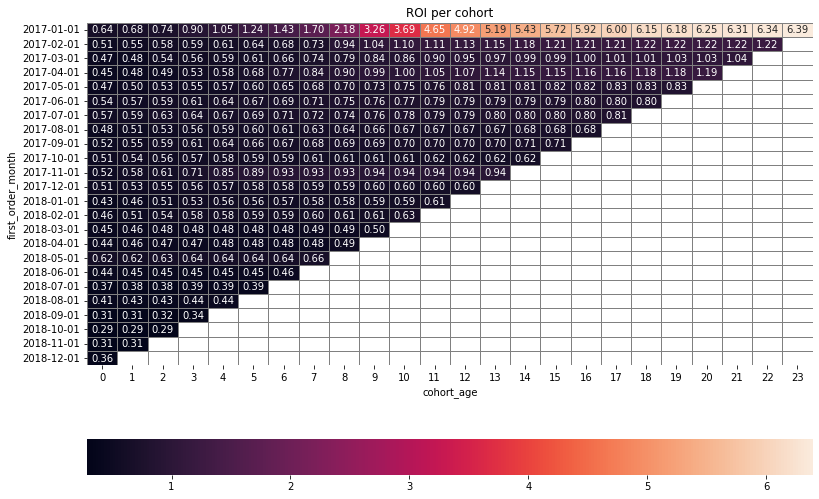

In [219]:
#create heat map

pivot_ROI.index=pivot_ROI.index.astype(str)
plt.figure(figsize=(13, 9))
sns.heatmap(pivot_ROI, annot=True, fmt='.2f', linewidths=1, linecolor='grey', cbar_kws= {'orientation': 'horizontal'} 
            ).set(title ='ROI per cohort')
plt.show()

no suprise that it is similar to the ltv heatmap (orders_ltv_cohort), since ROI in a ratio of ltv. in general, the cohorts that had the best ltv also have the best ROI. it confirms what privously suspected, the picks in visits (by time) corolate to picks in revenue, and to picks in ROI, and the best cohorts, are the cohorts in which there was more investment, there was more return on investment.

##### ROI per source

from previouse analyses we already know which are the most "expensive" sources, but in order to find which are the most profitable, we need to calculate ROI per source.

In [220]:
#in df_orders we already have first_source for each Uid - let's find the amount of users and revenue for each source,
#so we'll have every thing we need in order to calculate ltv per source

ltv_per_source = df_orders.groupby(['first_source'])['Uid','Revenue'].agg({'Uid':'nunique','Revenue':'sum'}).reset_index()

In [221]:
ltv_per_source.columns = ['source_id','customers','revenue']

In [222]:
ltv_per_source['ltv']=ltv_per_source['revenue']/ltv_per_source['customers']

ltv_per_source

,source_id,customers,revenue,ltv
0,1,2947,36118.69,12.256088
1,2,3655,49165.88,13.451677
2,3,9378,49251.42,5.251804
3,4,9574,51842.46,5.414922
4,5,6972,54322.29,7.791493
5,9,1156,7004.34,6.059118
6,10,1136,4352.12,3.831092


In [223]:
#create new subset od al needed data, by source, by merging ltv_per_source with costs_per_source (created erlier)

roi_per_source = costs_per_source.merge(ltv_per_source,on=['source_id'])
roi_per_source

,source_id,costs,customers,revenue,ltv
0,1,20833.27,2947,36118.69,12.256088
1,2,42806.04,3655,49165.88,13.451677
2,3,141321.63,9378,49251.42,5.251804
3,4,61073.60,9574,51842.46,5.414922
4,5,51757.10,6972,54322.29,7.791493
5,9,5517.49,1156,7004.34,6.059118
6,10,5822.49,1136,4352.12,3.831092


In [224]:
#calculate CAC by source

roi_per_source['CAC'] = roi_per_source['costs']/roi_per_source['customers']

In [225]:
#calculate ROMI returne on marketing investment

roi_per_source['ROMI']=roi_per_source['ltv']/roi_per_source['CAC']
roi_per_source

,source_id,costs,customers,revenue,ltv,CAC,ROMI
0,1,20833.27,2947,36118.69,12.256088,7.069315,1.733702
1,2,42806.04,3655,49165.88,13.451677,11.711639,1.148573
2,3,141321.63,9378,49251.42,5.251804,15.069485,0.348506
3,4,61073.60,9574,51842.46,5.414922,6.379110,0.848852
4,5,51757.10,6972,54322.29,7.791493,7.423566,1.049562
5,9,5517.49,1156,7004.34,6.059118,4.772915,1.269479
6,10,5822.49,1136,4352.12,3.831092,5.125431,0.747467


In [226]:
#visualize the results

fig = px.bar(roi_per_source, x='source_id', y='ROMI', width=800, height=400, title='overall ROMI per source')
fig.update_xaxes(type='category')
fig.add_hline(y=roi_per_source['ROMI'].mean(),line_dash="dash", line_color="purple", annotation_text="average ROMI - {}".format(roi_per_source['ROMI'].mean().round(2)),
             annotation_position="top left")
fig.update_xaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.update_yaxes(showgrid=True, gridwidth=0.5, gridcolor='lightgrey')
fig.show()

sources 2 and 3 were the most expensive as far as CAC, and source 3 was the overall most expensive as far as costs_per_source.
even thoght it is reletevly expensive, the ROI of source 2 is similar to the ROI of most other sources and is about equal to avarage. the ROI of source 3 is very low compare to other sources and compare to the avarage

source 1 was the cheapest overall as far as costs_per_source, and simmilar to others as far as CAC, but had the highst return on investment.

##### ROI per month, per source

in this analysis we'll redo the ROI cohort analysis, but this time, we'll break down the cohort analysis for each source.
this will be done by creating a function.

In [227]:
def roi_per_source(source):
    
    #create subset of orders table for only one source
    new_orders=df_orders[df_orders.first_source==source]
    
    #create subset of costs table for only one source
    new_costs=df_costs[df_costs.source_id==source]
    
    
    #create cohort by grouping the data by cohort and lifetime and find the number of initial amount of users 
    #for each cohort for each cohort lifetime
    orders_cohorts_source = (new_orders.groupby(['first_order_month','order_month', 'cohort_age']).agg({'Uid': 'nunique'}).reset_index())
    orders_cohorts_source = orders_cohorts_source.rename(columns={'Uid': 'cohort_active_users'}) 
    #find the initial number of customers in each cohort (by looking at the 0th week)
    initial_customers_count_source = orders_cohorts_source[orders_cohorts_source['cohort_age'] == 0][['first_order_month', 'cohort_active_users']]
    initial_customers_count_source = initial_customers_count_source.rename(columns={'cohort_active_users': 'cohort_size'}) 
    # add cohort_users column to cohorts dataset
    orders_cohorts_source = orders_cohorts_source.merge(initial_customers_count_source, on='first_order_month') 
     
        
    #calculating ltv only for one source
    
    #calculate the total revenue per cohort in each month
    ltv_cohort_source = new_orders.groupby(['first_order_month','order_month'])['Revenue'].sum().reset_index()
    ltv_cohort_source.rename(columns={"Revenue": "total_revenue"}, inplace=True)
    #merge with the orders_cohorts_source
    orders_cohorts_source=orders_cohorts_source.merge(ltv_cohort_source,on=['first_order_month', 'order_month'])
    #find our LTV
    orders_cohorts_source['ltv']=orders_cohorts_source['total_revenue']/orders_cohorts_source['cohort_size']
    # create a subset of orders_cohorts_source with the needed columns
    monthly_ltv_source = orders_cohorts_source[['first_order_month','order_month','cohort_age', 'ltv']]    
    
    
    #calculating CAC only for one source
    
    #calculate total_monthly_cost
    total_monthly_cost_source = new_costs.groupby(['month_of_expense'])['costs'].sum().reset_index()
    #find the amount of customers_per_month from new_orders using first_order_month
    customers_per_month_source = new_orders.groupby(['first_order_month'])['Uid'].nunique().reset_index()
    customers_per_month_source.columns=['month_of_expense','customers_per_month']
    #merge the 2 datasets
    CAC_per_month_source = total_monthly_cost_source.merge(customers_per_month_source,how='left',on=['month_of_expense'])
    #calculate monthly CAC
    CAC_per_month_source['CAC'] = CAC_per_month_source['costs']/CAC_per_month_source['customers_per_month']
    # make a subset of CAC_per_month_source with the needed columns
    monthly_CAC_source = CAC_per_month_source[['month_of_expense','CAC']]
    #rename the columns
    monthly_CAC_source.rename(columns={"month_of_expense": "first_order_month"}, inplace=True)


    #calculating ROI only for one source

    
    #merge monthly_CAC_source with monthly_ltv_source
    ROI_cohort_source = monthly_ltv_source.merge(monthly_CAC_source,on=['first_order_month'],how='left')
    #calculate ROI
    ROI_cohort_source['ROI']=ROI_cohort_source['ltv']/ROI_cohort_source['CAC']
    # visualize in pivot table
    pivot_ROI_source = ROI_cohort_source.pivot_table(index='first_order_month', columns='cohort_age', values='ROI', aggfunc='mean').cumsum(axis=1).round(2) 
    
    
    print('ROI cohort analysis for source {}'.format(source))
    print('-----------------------------------')
    print(ROI_cohort_source.head())
    print(pivot_ROI_source)
  
    #create heat map
    pivot_ROI_source.index=pivot_ROI_source.index.astype(str)
    plt.figure(figsize=(13, 9))
    sns.heatmap(pivot_ROI_source, annot=True, fmt='.2f', linewidths=1, linecolor='grey', cbar_kws= {'orientation': 'horizontal'} 
            ).set(title ='ROI per cohort, for source {}'.format(source))
    plt.show()


ROI cohort analysis for source 1
-----------------------------------
  first_order_month order_month  cohort_age        ltv       CAC       ROI
0        2017-01-01  2017-01-01           0  11.161170  3.693617  3.021745
1        2017-01-01  2017-02-01           1   1.317447  3.693617  0.356682
2        2017-01-01  2017-03-01           2   1.295000  3.693617  0.350605
3        2017-01-01  2017-04-01           3   1.625106  3.693617  0.439977
4        2017-01-01  2017-05-01           4   2.274787  3.693617  0.615870
cohort_age           0     1     2     3     4     5     6     7      8   \
first_order_month                                                          
2017-01-01         3.02  3.38  3.73  4.17  4.78  5.59  6.80  7.85  10.59   
2017-02-01         0.90  1.22  1.23  1.24  1.31  1.43  1.46  1.50   1.85   
2017-03-01         0.89  1.02  1.11  1.23  1.29  1.33  1.52  1.53   1.59   
2017-04-01         0.46  0.58  0.65  0.72  1.19  1.59  1.99  2.17   2.31   
2017-05-01         0.85  

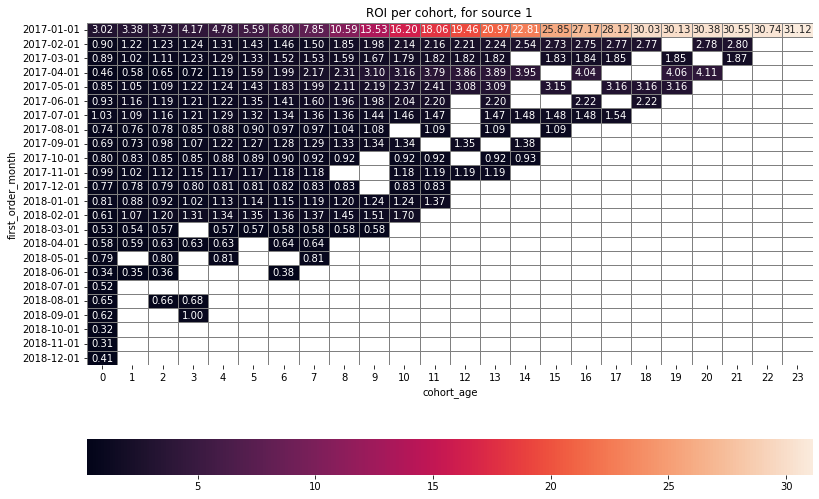

In [228]:
#make sure function works

roi_per_source(1)

In [229]:
# find only the sources in the costs table (these will be the relevent sources for ROI analysis)

list1= df_costs.source_id.unique()
list1

array([ 1,  2,  3,  4,  5,  9, 10], dtype=int64)

ROI cohort analysis for source 1
-----------------------------------
  first_order_month order_month  cohort_age        ltv       CAC       ROI
0        2017-01-01  2017-01-01           0  11.161170  3.693617  3.021745
1        2017-01-01  2017-02-01           1   1.317447  3.693617  0.356682
2        2017-01-01  2017-03-01           2   1.295000  3.693617  0.350605
3        2017-01-01  2017-04-01           3   1.625106  3.693617  0.439977
4        2017-01-01  2017-05-01           4   2.274787  3.693617  0.615870
cohort_age           0     1     2     3     4     5     6     7      8   \
first_order_month                                                          
2017-01-01         3.02  3.38  3.73  4.17  4.78  5.59  6.80  7.85  10.59   
2017-02-01         0.90  1.22  1.23  1.24  1.31  1.43  1.46  1.50   1.85   
2017-03-01         0.89  1.02  1.11  1.23  1.29  1.33  1.52  1.53   1.59   
2017-04-01         0.46  0.58  0.65  0.72  1.19  1.59  1.99  2.17   2.31   
2017-05-01         0.85  

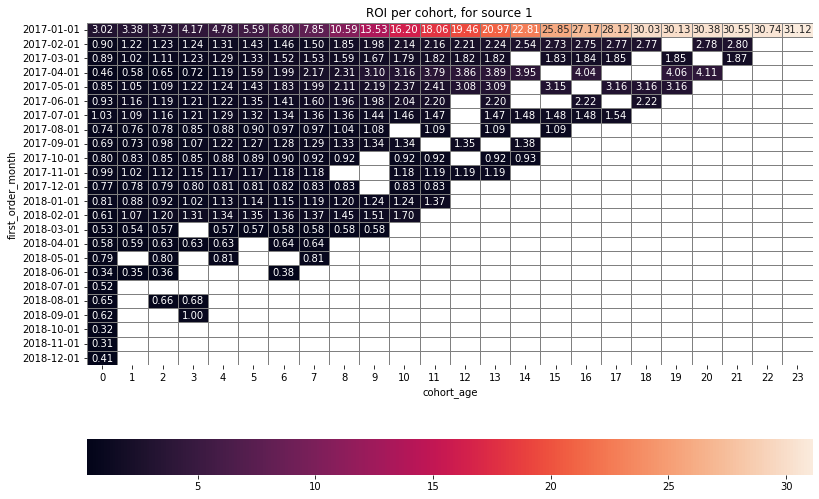

ROI cohort analysis for source 2
-----------------------------------
  first_order_month order_month  cohort_age       ltv       CAC       ROI
0        2017-01-01  2017-01-01           0  4.160841  7.778879  0.534890
1        2017-01-01  2017-02-01           1  0.407570  7.778879  0.052394
2        2017-01-01  2017-03-01           2  1.439159  7.778879  0.185009
3        2017-01-01  2017-04-01           3  4.818972  7.778879  0.619494
4        2017-01-01  2017-05-01           4  5.069907  7.778879  0.651753
cohort_age           0     1     2     3     4     5     6     7     8   \
first_order_month                                                         
2017-01-01         0.53  0.59  0.77  1.39  2.04  2.48  2.71  3.65  4.86   
2017-02-01         0.65  0.72  0.84  0.86  0.94  0.98  1.11  1.34  2.45   
2017-03-01         0.58  0.60  0.61  0.64  0.70  0.72  0.83  1.26  1.35   
2017-04-01         0.59  0.61  0.62  0.74  0.75  0.79  0.84  0.89  0.91   
2017-05-01         0.68  0.71  0.85  

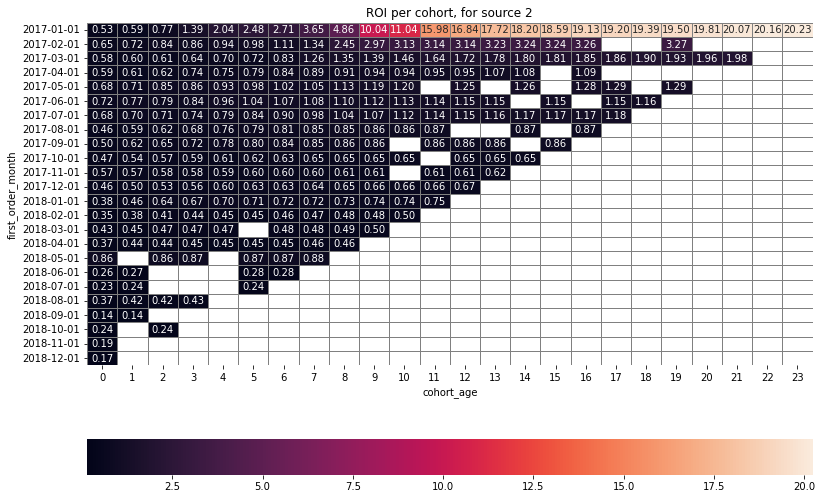

ROI cohort analysis for source 3
-----------------------------------
  first_order_month order_month  cohort_age       ltv        CAC       ROI
0        2017-01-01  2017-01-01           0  3.373550  15.110296  0.223262
1        2017-01-01  2017-02-01           1  0.071183  15.110296  0.004711
2        2017-01-01  2017-03-01           2  0.071598  15.110296  0.004738
3        2017-01-01  2017-04-01           3  0.128994  15.110296  0.008537
4        2017-01-01  2017-05-01           4  0.146923  15.110296  0.009723
cohort_age           0     1     2     3     4     5     6     7     8     9   \
first_order_month                                                               
2017-01-01         0.22  0.23  0.23  0.24  0.25  0.26  0.26  0.27  0.27  0.30   
2017-02-01         0.18  0.18  0.20  0.20  0.20  0.21  0.21  0.23  0.25  0.26   
2017-03-01         0.26  0.27  0.27  0.28  0.28  0.29  0.30  0.31  0.32  0.34   
2017-04-01         0.24  0.26  0.27  0.28  0.29  0.30  0.31  0.35  0.36  0.3

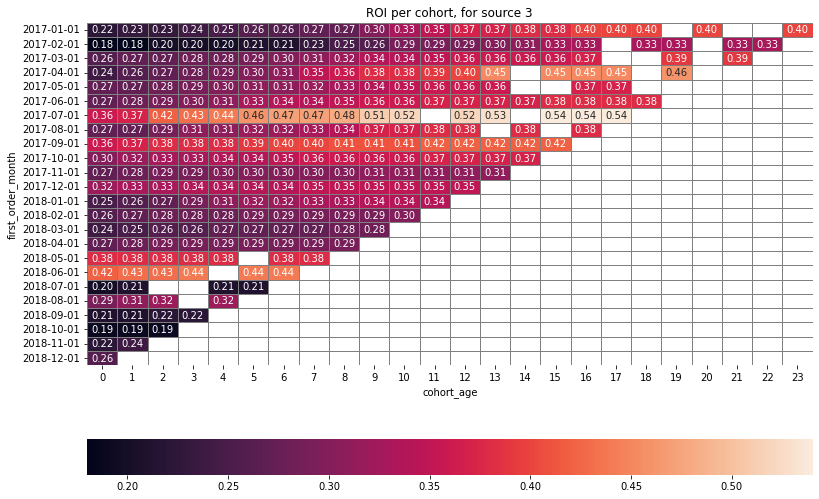

ROI cohort analysis for source 4
-----------------------------------
  first_order_month order_month  cohort_age       ltv       CAC       ROI
0        2017-01-01  2017-01-01           0  4.388042  4.809371  0.912394
1        2017-01-01  2017-02-01           1  0.040210  4.809371  0.008361
2        2017-01-01  2017-03-01           2  0.102517  4.809371  0.021316
3        2017-01-01  2017-04-01           3  0.179441  4.809371  0.037311
4        2017-01-01  2017-05-01           4  0.301259  4.809371  0.062640
cohort_age           0     1     2     3     4     5     6     7     8     9   \
first_order_month                                                               
2017-01-01         0.91  0.92  0.94  0.98  1.04  1.36  1.42  1.52  1.57  1.78   
2017-02-01         0.78  0.82  0.83  0.84  0.84  0.87  0.89  0.93  0.98  1.02   
2017-03-01         0.57  0.58  0.61  0.63  0.68  0.70  0.75  0.82  0.93  1.01   
2017-04-01         0.38  0.46  0.46  0.47  0.49  0.64  0.66  0.68  0.77  0.85   
2

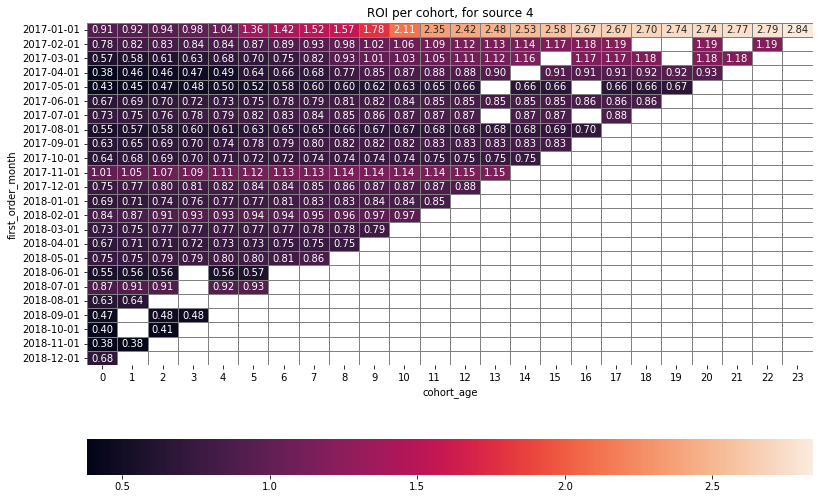

ROI cohort analysis for source 5
-----------------------------------
  first_order_month order_month  cohort_age       ltv     CAC       ROI
0        2017-01-01  2017-01-01           0  4.750867  5.8578  0.811033
1        2017-01-01  2017-02-01           1  0.337267  5.8578  0.057576
2        2017-01-01  2017-03-01           2  0.354133  5.8578  0.060455
3        2017-01-01  2017-04-01           3  0.760133  5.8578  0.129764
4        2017-01-01  2017-05-01           4  0.220267  5.8578  0.037602
cohort_age           0     1     2     3     4     5     6     7     8     9   \
first_order_month                                                               
2017-01-01         0.81  0.87  0.93  1.06  1.10  1.24  1.68  1.92  2.60  3.04   
2017-02-01         0.84  0.84  0.84  0.84  0.89  0.90  1.00  1.01  1.03  1.04   
2017-03-01         0.63  0.65  0.90  0.92  0.98  1.06  1.10  1.13  1.19  1.28   
2017-04-01         0.84  0.85   NaN  0.90  0.93  0.96  1.25  1.36  1.48  1.56   
2017-05-01   

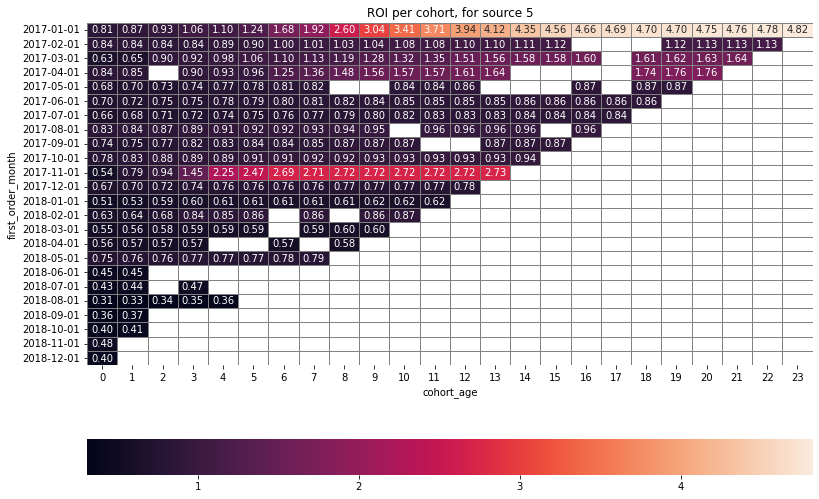

ROI cohort analysis for source 9
-----------------------------------
  first_order_month order_month  cohort_age       ltv       CAC       ROI
0        2017-01-01  2017-01-01           0  3.525263  6.023158  0.585285
1        2017-01-01  2017-04-01           3  0.640526  6.023158  0.106344
2        2017-01-01  2017-06-01           5  0.186316  6.023158  0.030933
3        2017-01-01  2017-07-01           6  0.959474  6.023158  0.159297
4        2017-01-01  2017-08-01           7  0.225263  6.023158  0.037400
cohort_age           0     1     2     3     4     5     6     7     8     9   \
first_order_month                                                               
2017-01-01         0.59   NaN   NaN  0.69   NaN  0.72  0.88  0.92  1.21  1.25   
2017-02-01         0.69  0.72   NaN  0.72  0.74   NaN  0.87   NaN  1.16  1.26   
2017-03-01         1.22   NaN  1.23   NaN  1.27   NaN  1.36  1.38  1.40  1.68   
2017-04-01         1.48  1.62   NaN  1.66  2.36  3.91  4.58  5.52  5.68  5.89   
2

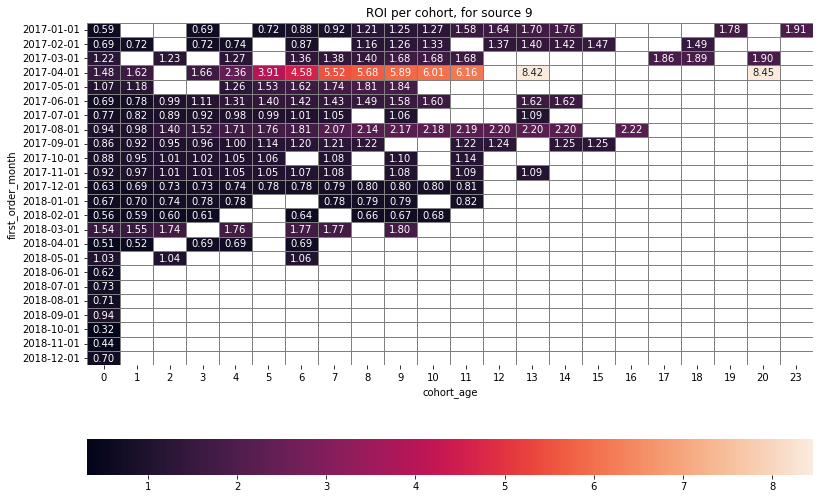

ROI cohort analysis for source 10
-----------------------------------
  first_order_month order_month  cohort_age       ltv       CAC       ROI
0        2017-01-01  2017-01-01           0  2.710000  7.529091  0.359937
1        2017-01-01  2017-02-01           1  0.000000  7.529091  0.000000
2        2017-01-01  2017-08-01           7  0.666364  7.529091  0.088505
3        2017-01-01  2017-10-01           9  0.110909  7.529091  0.014731
4        2017-01-01  2017-11-01          10  0.110909  7.529091  0.014731
cohort_age           0     1     2     3     4     5     6     7     8     9   \
first_order_month                                                               
2017-01-01         0.36  0.36   NaN   NaN   NaN   NaN   NaN  0.45   NaN  0.46   
2017-02-01         0.45   NaN  0.48  0.48  0.51   NaN  0.57   NaN   NaN  0.68   
2017-03-01         0.55  0.55   NaN   NaN  0.62   NaN  0.63  0.92   NaN  0.93   
2017-04-01         0.60   NaN   NaN   NaN   NaN   NaN  0.61   NaN  0.69  0.73   


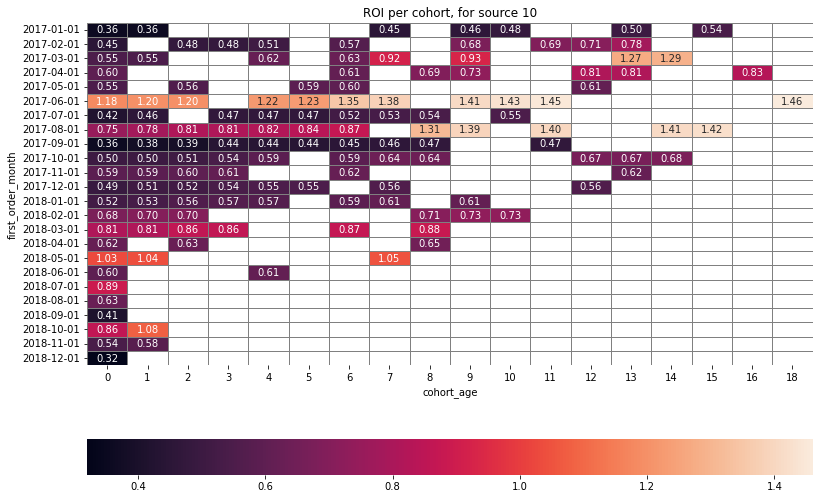

In [230]:
# applying the function to relevent sources

for source in list1:
    roi_per_source(source)

#### conclusion on marketing analysis

we can see that for some cohorts, there was a better return on investment than on others. 

in general, the higher the resolution of the analysis, the more variation and flactuations we see (fot instance, the difference between DAU graphs to MAU graphs, since days are a higher resolution than months). that is why there is variation between the ROI per cohort heatmap and the ROI cohort analysis per source heatmaps, but the overall trend of which are the best cohorts remains the same.

so we can see, that no matter the resolution (overall ROI or ROI per source), for the most part, the same cohorts that stood out in the sales analyses, prove to be the most profitable also in the ROI analyses.

when looking at overall ROI per source, we can also see, that source 3 in particular, which was the most expensive has very little return on investment, and there for not worth the investment. on the opposite side, source 1 had a much lower investment, but attracted a reletevly large amount of customer, so it's return on investment was high,  which makes is very profitable compare to all other sources.

## general conclution

Write a conclusion: advise marketing experts how much money to invest and where.
What sources/platforms would you recommend? Back up your choice: what metrics did you focus on? Why? What conclusions did you draw after finding the metric values?

general conclutionin this assingment we were tasked with analizing sales, orders and marketing cost of Yandex.Afisha in order to optimize marketing expenses.

in this assingment, we carried out several steps:
- took an initial glance at the data.
- found several issues with the data such as incorrect data types, and fix what was needed.
- enriched the data, mostly by adding date values that were required for our analyses.
- performed calculations and visualized them in order to identify trends in user visits and purchases.
- performed calculations and visualized them in order to identify the most profitable marketing sources.

in conclution, we can advise the marketing experts as follows:
- as far a as the dates and seasons - the higher investment in particular periods (such as spesific dates like black friday, and specific months or seaons like summer vacation and decemper holidays) has proven itself worthie, since these were the periods that attracted a lot of visitors traffic, and attracted customers with good LTV (customer's lifetime value), and good ROI (return on investment). as a result, the recommendation is to continue this marketing strategy.
- as far as sources - we have several recommendations:
1) source 3 - very expensive, but has very low ROI. the recommendation is to significantly reduce marketing expenses for this source.
2) source 1 - reletevly cheap, but has high ROI. the recommendation is to increase the marketing expenses for this source.
3) desktop is the dominant device with which users visit the site. the recommendation is to increase the marketing expenses for sources that are more popular on desktop devices (excluding source 3).